In [681]:
from Bio import SeqIO
import glob
from gzip import open as gopen
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
import matplotlib.patches as mpatches
from matplotlib.legend_handler import HandlerPatch
from matplotlib.lines import Line2D
import numpy as np
from numpy import average, median
from scipy.stats import mannwhitneyu as mwu
from scipy.stats import kruskal, wilcoxon
from statsmodels.stats.multitest import multipletests
from scipy.spatial.distance import euclidean
from scipy import stats
from os import path
import hashlib
from Bio import SeqIO
from scipy.stats import norm
from scipy.optimize import curve_fit
from scipy import asarray as ar,exp
from scipy import optimize
from Bio.KEGG import REST
from Bio.KEGG import Enzyme
from collections import Counter
from itertools import chain
from sklearn import linear_model
from sklearn.model_selection import train_test_split 
from qiime2 import Artifact

%matplotlib inline

**Filter and subset tables**

In [45]:
# Remove Mitochondria, Chloroplast
!qiime taxa filter-table \
  --i-table dada/table.qza \
  --i-taxonomy dada/taxonomy.qza \
  --p-exclude Mitochondria,Chloroplast,Eukaryota,mitochondria,chloroplast,eukaryota \
  --o-filtered-table temp.qza

# Remove low frequency features
!qiime feature-table filter-features \
  --i-table temp.qza \
  --p-min-frequency 30 \
  --o-filtered-table dada/table.filtered.qza

!qiime feature-table summarize \
  --i-table dada/table.filtered.qza \
  --o-visualization dada/table.filtered.qzv

!qiime feature-table filter-samples \
  --i-table dada/table.filtered.qza \
  --m-metadata-file metadata.tsv \
  --p-where "[Fraction] IN ('water')" \
  --o-filtered-table dada/table.water.qza

!qiime feature-table filter-samples \
  --i-table dada/table.filtered.qza \
  --m-metadata-file metadata.tsv \
  --p-where "[Fraction] IN ('epiphyte')" \
  --o-filtered-table dada/table.epiphyte.qza

!qiime feature-table filter-samples \
  --i-table dada/table.filtered.qza \
  --m-metadata-file metadata.tsv \
  --p-where "[Fraction] IN ('Field')" \
  --o-filtered-table dada/table.field.qza

!qiime feature-table filter-samples \
  --i-table dada/table.filtered.qza \
  --m-metadata-file metadata.tsv \
  --p-where "[Fraction] NOT IN ('Field')" \
  --o-filtered-table dada/table.nofield.qza

table = Artifact.load('dada/table.epiphyte.qza').view(pd.DataFrame)
water = Artifact.load('dada/table.water.qza').view(pd.DataFrame)
table = table.loc[:,[i for i in table.columns if i not in water.columns.tolist()]]
table.index.name = '#SampleID'
table.transpose().to_csv('temp',sep='\t')
!biom convert -i temp -o temp.biom --table-type="OTU table" --to-hdf5
!qiime tools import \
  --input-path temp.biom \
  --type 'FeatureTable[Frequency]' \
  --input-format BIOMV210Format \
  --output-path dada/table.epiphyte.no_water.qza

!qiime feature-table filter-samples \
  --i-table dada/table.epiphyte.no_water.qza \
  --m-metadata-file metadata.tsv \
  --p-where "[T] IN ('0tp')" \
  --o-filtered-table dada/table.0tp.qza

!qiime feature-table filter-samples \
  --i-table dada/table.epiphyte.no_water.qza \
  --m-metadata-file metadata.tsv \
  --p-where "[T] IN ('3tp')" \
  --o-filtered-table dada/table.3tp.qza

!qiime feature-table filter-samples \
  --i-table dada/table.epiphyte.no_water.qza \
  --m-metadata-file metadata.tsv \
  --p-where "[T] IN ('5tp')" \
  --o-filtered-table dada/table.5tp.qza

!qiime feature-table filter-samples \
  --i-table dada/table.epiphyte.no_water.qza \
  --m-metadata-file metadata.tsv \
  --p-where "[T] IN ('8tp')" \
  --o-filtered-table dada/table.8tp.qza

!qiime taxa collapse \
  --i-table dada/table.epiphyte.no_water.qza \
  --i-taxonomy dada/taxonomy.qza \
  --p-level 4 \
  --o-collapsed-table dada/table.epiphyte.no_water.l4.qza

!qiime taxa collapse \
  --i-table dada/table.epiphyte.no_water.qza \
  --i-taxonomy dada/taxonomy.qza \
  --p-level 6 \
  --o-collapsed-table dada/table.epiphyte.no_water.l6.qza

Saved FeatureTable[Frequency] to: temp.qza
Saved FeatureTable[Frequency] to: dada/table.filtered.qza
Saved Visualization to: dada/table.filtered.qzv
Saved FeatureTable[Frequency] to: dada/table.water.qza
Saved FeatureTable[Frequency] to: dada/table.epiphyte.qza
Saved FeatureTable[Frequency] to: dada/table.field.qza
Saved FeatureTable[Frequency] to: dada/table.nofield.qza
Imported temp.biom as BIOMV210Format to dada/table.epiphyte.no_water.qza
Saved FeatureTable[Frequency] to: dada/table.0tp.qza
Saved FeatureTable[Frequency] to: dada/table.3tp.qza
Saved FeatureTable[Frequency] to: dada/table.5tp.qza
Saved FeatureTable[Frequency] to: dada/table.8tp.qza
Saved FeatureTable[Frequency] to: dada/table.epiphyte.no_water.l4.qza
Saved FeatureTable[Frequency] to: dada/table.epiphyte.no_water.l6.qza


**Bar plot and alpha rarefaction**

In [3]:
!mkdir rarefaction_curve_and_barplot

!qiime taxa barplot \
  --i-table dada/table.epiphyte.no_water.qza \
  --i-taxonomy dada/taxonomy.qza \
  --m-metadata-file metadata.tsv \
  --o-visualization rarefaction_curve_and_barplot/barplot.qzv

!qiime diversity alpha-rarefaction \
  --i-table dada/table.epiphyte.no_water.qza  \
  --i-phylogeny dada/rooted-tree.qza \
  --p-max-depth 7000 \
  --m-metadata-file metadata.tsv \
  --o-visualization rarefaction_curve_and_barplot/curve.qzv



mkdir: cannot create directory ‘rarefaction_curve_and_barplot’: File exists
Saved Visualization to: rarefaction_curve_and_barplot/barplot.qzv
Saved Visualization to: rarefaction_curve_and_barplot/curve.qzv


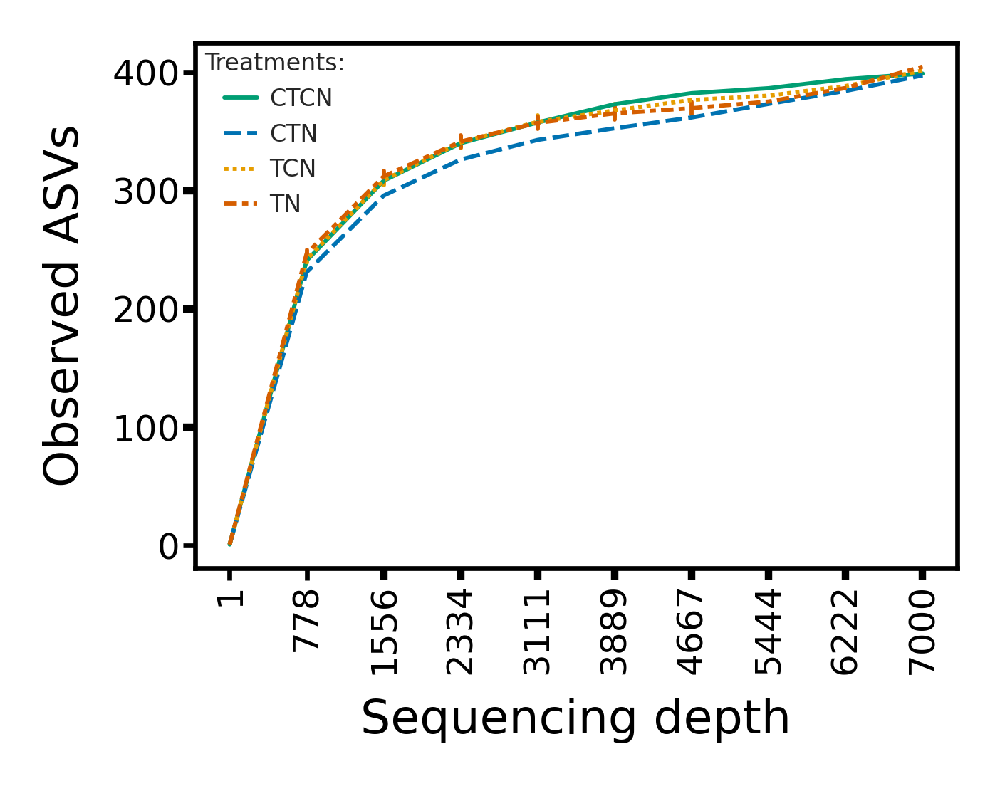

In [4]:
qza = 'rarefaction_curve_and_barplot/curve.qzv'
a = !unzip $qza
digest = a[1].split('/')[0].replace('  inflating: ','')
inf = digest + '/data/observed_features.csv'
otus = pd.read_csv(inf,index_col=0, sep=',')
!rm -r $digest

cols = [col for col in otus.columns if 'iter' not in col]
mean,data = otus[cols],pd.DataFrame(columns=cols)
depths = [col.split('_')[0] for col in otus.columns if 'depth' in col]
otus = otus.drop(cols,axis=1)
otus.columns = depths
for depth in depths:
    mean['ASV'] = otus[depth].mean(axis=1)
    mean['depth']= depth.split('-')[-1]
    data = pd.concat([data,mean])

pal={'CTCN':'#009e73','CTN':'#0072b2','TCN':'#e69d00','TN':'#d55e00'}
fig,ax = plt.subplots(figsize=(2.5,2),dpi=600,tight_layout=True)
sns.set(style='ticks',rc={"lines.linewidth":0.7,"axes.linewidth":0.5})
sns.lineplot(x='depth',y='ASV',data=data,palette=pal,hue='Treatment',sort=False,err_style='bars',dashes=True,style='Treatment')

ax.set_xlabel('Sequencing depth',fontsize=8)
ax.set_ylabel('Observed ASVs',fontsize=8)
ax.tick_params(axis='x', labelrotation=90)
ax.tick_params(axis='both',which='major',length=2,pad=0.5,labelsize=6)
handles, labels = ax.get_legend_handles_labels()
ax.legend(title='Treatments:',title_fontsize=4,handles=handles[0:],labels=labels[0:],fontsize=4,frameon=False,numpoints=4,borderaxespad=0,handletextpad=0.2,loc=2)
plt.savefig('Figures/FigS1.png', bbox_inches='tight')

**Order level relative abundances**

In [682]:
from qiime2 import Artifact

narrow = pd.DataFrame(columns = ['taxon','order','Treatment','TP','SourceSite','Relative Abundance'])

metadata = pd.read_csv('metadata.tsv',sep='\t',index_col=0)

!qiime feature-table relative-frequency \
    --i-table dada/table.epiphyte.no_water.l4.qza \
    --o-relative-frequency-table temp.qza
    
a = Artifact.load('temp.qza')
table = a.view(pd.DataFrame).transpose()

for taxon in table.index.tolist():
    for col in table:
        treatment = metadata.at[col,'Treatment']
        tp = metadata.at[col,'TP']
        site = metadata.at[col,'SourceSite']
        narrow.loc[len(narrow)] = [taxon,taxon.split('__')[-1],treatment,tp,site,table.at[taxon,col]]

!rm temp.qza

Saved FeatureTable[RelativeFrequency] to: temp.qza


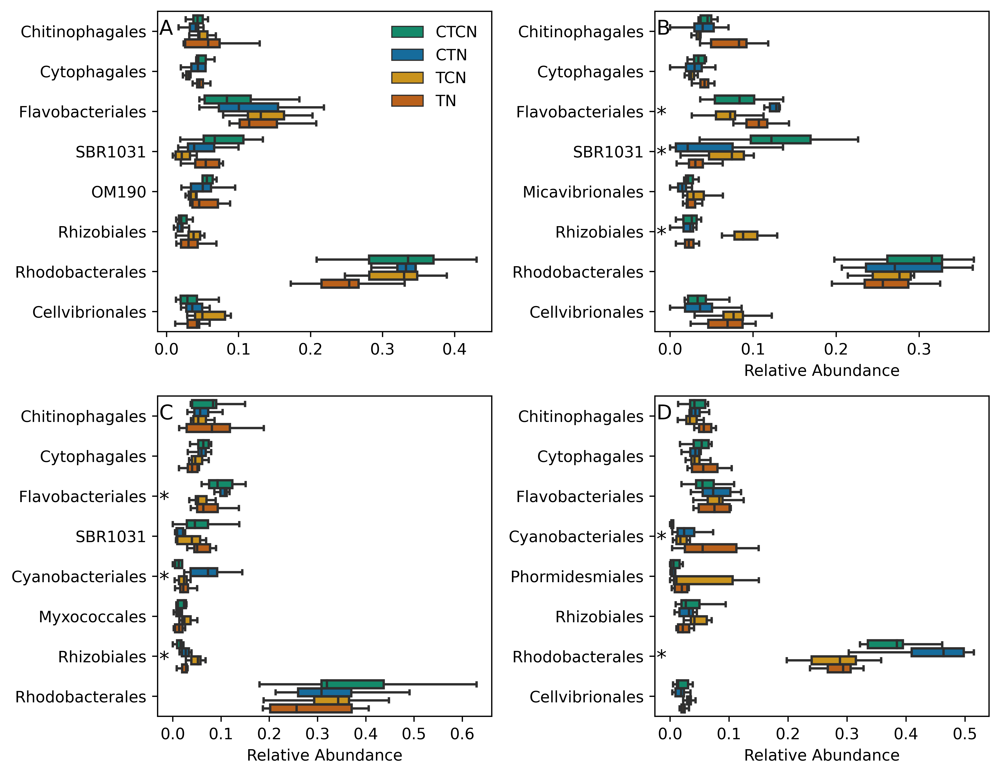

In [683]:
fig, axes = plt.subplots(nrows = 2, ncols=2, dpi=600, figsize=(9,7),tight_layout=True)
ax_labels = ['A','B','C','D']
timepoints = [0,3,5,8]

all_top_orders = set()

!mkdir high_abundance_orders

for row in axes:
    for ax in row:
        
        tp = timepoints.pop(0)

        averages = {}

        for order in set(narrow.loc[narrow.TP==tp].order):
            if 'NA' in order:
                continue
            averages[order] = np.average(narrow.loc[((narrow.order==order)&(narrow.TP==tp))]['Relative Abundance'])


        top_orders = [i[0] for i in sorted(averages.items(), key=lambda h: h[1], reverse=True)[:8]]
        
        all_top_orders.update(top_orders)

        a = narrow.loc[(narrow.order.isin(top_orders) & (narrow.TP==tp))]

        a.pivot_table(index=['order','Treatment']).to_csv('high_abundance_orders/timepoint_%i_top_orders.tsv' % tp,sep='\t')

        sns.boxplot(x='Relative Abundance',y='order',data=a,hue='Treatment',hue_order=['CTCN','CTN','TCN','TN'],
                      ax=ax,palette=['#009e73','#0072b2','#e69d00','#d55e00'],showfliers=False)

        if len(ax_labels) < 4:
            ax.legend().remove()
        else:
            ax.set_xlabel('')

        ax.set_ylabel('')
        ax.annotate(ax_labels.pop(0),xy=(0,1),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)

        if tp == 0:
            ax.legend(frameon=False)
        elif tp == 3:
            ax.annotate('*',xy=(0,0.73),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
            ax.annotate('*',xy=(0,0.605),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
            ax.annotate('*',xy=(0,0.355),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
        elif tp == 5:
            ax.annotate('*',xy=(0,0.73),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
            ax.annotate('*',xy=(0,0.48),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
            ax.annotate('*',xy=(0,0.23),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
        elif tp == 8:
            ax.annotate('*',xy=(0,0.605),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
            ax.annotate('*',xy=(0,0.235),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)

        
#plt.savefig('Fig1.png',bbox_inches='tight')

/home/amir/anaconda3/envs/qiime2-2020.11/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


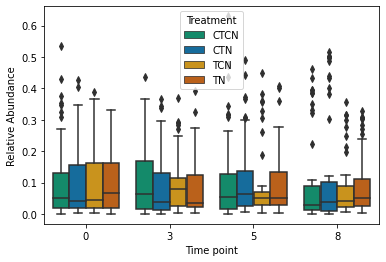

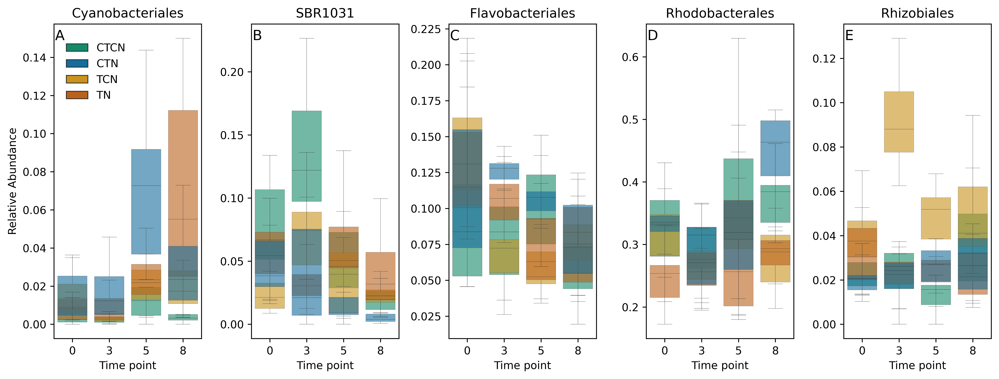

In [684]:
a = narrow.loc[(narrow.order.isin(['Cyanobacteriales','Rhodobacterales','Flavobacteriales','Rhizobiales','SBR1031']))]
a['Time point'] = a.TP.astype(int)
fig, j =plt.subplots()
sns.boxplot(x='Time point',y='Relative Abundance',data=a, hue='Treatment',palette=['#009e73','#0072b2','#e69d00','#d55e00'],ax = j)
handles, labels = j.get_legend_handles_labels()


fig, axes = plt.subplots(ncols=5,tight_layout=True, figsize=(13,5),dpi=600)

ind = 0

ax_labels = list("ABCDE")

for order in set(a.order):
    colors = ['#009e73','#e69d00','#d55e00','#0072b2']
    ax = axes[ind]
    for treat in ['CTCN','TCN','TN','CTN']:
        
        sns.boxplot(x='Time point', linewidth=0.2,
                    y='Relative Abundance',
                    data=a.loc[((a.order==order)&(a.Treatment==treat))],
                    color=colors.pop(0),
                    ax=ax,
                    showfliers=False,boxprops=dict(alpha=.6))

    ax.annotate(ax_labels.pop(0),xy=(0,1),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)

    if ind != 0:
        ax.legend().remove()
        ax.set_ylabel('')
    else:
        ax.legend(handles, labels, frameon=False,loc=0,bbox_to_anchor=(0.55,0.97))

    #bottom, top = ax.get_ylim()
    #for i in [0.5, 1.5, 2.5]:
    #    ax.axvline(x=i,ymin=0,ymax=1,color='orange')
    ax.set_title(order)
    
    ind += 1
    
fig.savefig('temp_figs/sig_boxplot.png',bbox_inches='tight')

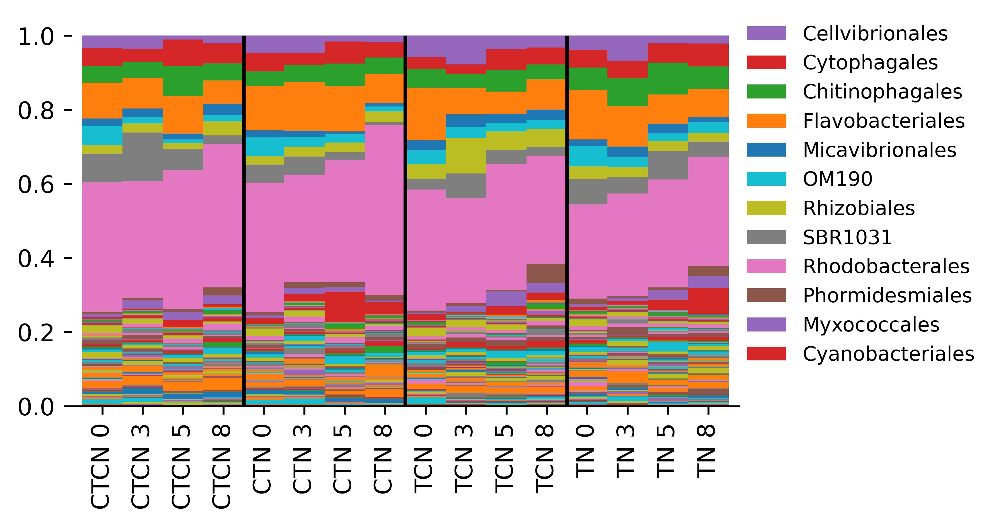

In [685]:
fig, ax = plt.subplots(figsize=(5,3),dpi=600)
narrow['Time Point'] = narrow.TP.astype(int)
a = pd.pivot_table(narrow,index = ['Treatment','Time Point'], columns = ['order'],values='Relative Abundance', aggfunc='mean')
a.index = ["%s %i" % i for i in a.index]
a = a.div(a.sum(axis=1), axis=0)
columns = [i for i in a.columns if i not in all_top_orders] + list(all_top_orders)
a = a.loc[:,columns]
a.plot(kind='bar',stacked=True,ax=ax,width=1)
handles, labels = ax.get_legend_handles_labels()
# Draw the legend
ax.legend(handles[::-1][:12], 
          labels[::-1][:12],
          bbox_to_anchor=(1, 1),
          loc=2, 
          borderaxespad=0.,
          fontsize='small',
          frameon=False) 
ax.vlines([3.5,7.5,11.5],ymin=0,ymax=1)
sns.despine(left=True)
fig.savefig('temp_figs/bars.png',bbox_inches='tight')

**Test significant differences among treatments for each order in each time point**

In [8]:
from scipy.stats import kruskal
from statsmodels.stats.multitest import multipletests

kruskal_results = pd.DataFrame(columns=['Order','TP','u','p'])

for order in set(narrow.order):
    for tp in set(narrow.TP):
        n = narrow.loc[((narrow.order==order)&(narrow.TP==tp))]
        sets = []
        for t in set(n.Treatment):
            sets.append(n.loc[n.Treatment==t]['Relative Abundance'])
        try:
            kout = kruskal(*sets)
        except:
            continue
        kruskal_results.loc[len(kruskal_results)] = [order,tp]+list(kout)
kruskal_results['q'] = list(multipletests(kruskal_results.p,method='fdr_bh'))[1] 

**Time point 0**

In [9]:
kruskal_results.loc[((kruskal_results.q<0.05)&(kruskal_results.TP==0))]

,Order,TP,u,p,q
14,Bdellovibrionales,0.0,15.450450,0.001469,0.016527
18,Phycisphaerales,0.0,14.158784,0.002697,0.021288
26,Puniceispirillales,0.0,14.212500,0.002630,0.021288
38,JTB23,0.0,11.798649,0.008106,0.044926
74,Microtrichales,0.0,20.843336,0.000113,0.008484
98,Dadabacteriales,0.0,24.252036,0.000022,0.005237
154,Opitutales,0.0,13.109234,0.004406,0.031534
208,BD2-11_terrestrial_group,0.0,20.833804,0.000114,0.008484
221,Ferrovibrionales,0.0,14.450943,0.002351,0.019759
269,Calditrichales,0.0,16.933076,0.000729,0.014077


**Time point 3**

In [10]:
kruskal_results.loc[((kruskal_results.q<0.05)&(kruskal_results.TP==3))].sort_values('Order')

,Order,TP,u,p,q
287,Alphaproteobacteria_Incertae_Sedis,3.0,24.041291,0.000024,0.005237
148,Alteromonadales,3.0,15.069871,0.001758,0.016961
16,Bdellovibrionales,3.0,14.169820,0.002683,0.021288
271,Calditrichales,3.0,17.312741,0.000609,0.013607
267,Candidatus_Peregrinibacteria,3.0,15.246327,0.001618,0.016527
100,Dadabacteriales,3.0,15.773053,0.001262,0.016527
428,Flavobacteriales,3.0,13.631757,0.003452,0.025691
84,Gracilibacteria,3.0,17.580561,0.000537,0.013316
484,Hydrogenedentiales,3.0,19.176265,0.000251,0.010914
40,JTB23,3.0,19.397262,0.000226,0.010717


**Time point 5**

In [11]:
kruskal_results.loc[((kruskal_results.q<0.05)&(kruskal_results.TP==5))].sort_values('Order')

,Order,TP,u,p,q
126,Ardenticatenales,5.0,15.660553,0.001331,0.016527
391,Balneolales,5.0,11.589013,0.008932,0.047975
50,Caulobacterales,5.0,15.412328,0.001496,0.016527
97,Cellvibrionales,5.0,15.319471,0.001563,0.016527
411,Chromatiales,5.0,13.819198,0.003162,0.024226
168,Coxiellales,5.0,15.915965,0.001180,0.016527
122,Cyanobacteriales,5.0,14.470265,0.002330,0.019759
101,Dadabacteriales,5.0,15.110581,0.001725,0.016953
429,Flavobacteriales,5.0,11.516429,0.009237,0.048613
265,Gammaproteobacteria_Incertae_Sedis,5.0,21.688915,0.000076,0.008484


**Time point 8**

In [12]:
kruskal_results.loc[((kruskal_results.q<0.05)&(kruskal_results.TP==8))].sort_values('Order')

,Order,TP,u,p,q
475,Absconditabacteriales_(SR1),8.0,11.325843,0.010088,0.049167
294,Acetothermiia,8.0,16.576908,0.000863,0.016066
124,Ardenticatenales,8.0,11.291325,0.010251,0.049449
321,Azospirillales,8.0,11.325843,0.010088,0.049167
505,BD7-11,8.0,17.253403,0.000627,0.013607
389,Balneolales,8.0,12.352459,0.006268,0.039642
15,Bdellovibrionales,8.0,15.804730,0.001243,0.016527
306,CCM11a,8.0,14.466890,0.002334,0.019759
23,Caenarcaniphilales,8.0,14.661399,0.002130,0.019759
120,Cyanobacteriales,8.0,15.996847,0.001136,0.016527


**Diversity, all samples**

In [23]:
depth=5000

!qiime diversity core-metrics-phylogenetic \
  --i-phylogeny dada/rooted-tree.qza \
  --i-table dada/table.nofield.qza \
  --p-sampling-depth $depth \
  --m-metadata-file metadata.tsv \
  --output-dir DIVERSITY_epiphytes_and_water


!qiime diversity pcoa \
  --i-distance-matrix DIVERSITY_epiphytes_and_water/weighted_unifrac_distance_matrix.qza \
  --p-number-of-dimensions 3 \
  --o-pcoa DIVERSITY_epiphytes_and_water/weighted_unifrac_pcoa_results.qza

!qiime feature-table relative-frequency \
  --i-table DIVERSITY_epiphytes_and_water/rarefied_table.qza \
  --o-relative-frequency-table temp.qza

!qiime diversity pcoa-biplot \
  --i-pcoa DIVERSITY_epiphytes_and_water/weighted_unifrac_pcoa_results.qza \
  --i-features temp.qza \
  --o-biplot DIVERSITY_epiphytes_and_water/weighted_unifrac_bplot_results.qza

Saved FeatureTable[Frequency] to: DIVERSITY_epiphytes_and_water/rarefied_table.qza
Saved SampleData[AlphaDiversity] to: DIVERSITY_epiphytes_and_water/faith_pd_vector.qza
Saved SampleData[AlphaDiversity] to: DIVERSITY_epiphytes_and_water/observed_features_vector.qza
Saved SampleData[AlphaDiversity] to: DIVERSITY_epiphytes_and_water/shannon_vector.qza
Saved SampleData[AlphaDiversity] to: DIVERSITY_epiphytes_and_water/evenness_vector.qza
Saved DistanceMatrix to: DIVERSITY_epiphytes_and_water/unweighted_unifrac_distance_matrix.qza
Saved DistanceMatrix to: DIVERSITY_epiphytes_and_water/weighted_unifrac_distance_matrix.qza
Saved DistanceMatrix to: DIVERSITY_epiphytes_and_water/jaccard_distance_matrix.qza
Saved DistanceMatrix to: DIVERSITY_epiphytes_and_water/bray_curtis_distance_matrix.qza
Saved PCoAResults to: DIVERSITY_epiphytes_and_water/unweighted_unifrac_pcoa_results.qza
Saved PCoAResults to: DIVERSITY_epiphytes_and_water/weighted_unifrac_pcoa_results.qza
Saved PCoAResults to: DIVERSITY

In [30]:
qza = 'DIVERSITY_epiphytes_and_water/faith_pd_vector.qza'
a = !unzip $qza
digest = a[1].split('/')[0].replace('  inflating: ','')
inf = digest + '/data/alpha-diversity.tsv'
faithpd = pd.read_csv(inf,index_col=0,sep='\t')
!rm -r $digest

metadata = pd.read_csv('metadata.tsv',sep='\t',index_col=0)
def get_fraction(string):
    return metadata.at[string,'Fraction']
def get_treatment(string):
    return metadata.at[string,'Treatment']
def get_site(string):
    return metadata.at[string,'SourceSite']
def get_tp(string):
    return metadata.at[string,'T']

faithpd['Fraction'] = faithpd.index.map(get_fraction)
faithpd['Treatment'] = faithpd.index.map(get_treatment)
faithpd['SourceSite'] = faithpd.index.map(get_site)
faithpd['TP'] = faithpd.index.map(get_tp)
faithpd.index.name = 'sample-id'
faithpd.to_csv('DIVERSITY_epiphytes_and_water/faithpd_anova.tsv',sep='\t')

!qiime longitudinal anova \
    --m-metadata-file DIVERSITY_epiphytes_and_water/faithpd_anova.tsv \
    --p-formula "faith_pd ~ Fraction + TP + Treatment + SourceSite" \
    --o-visualization DIVERSITY_epiphytes_and_water/faithpd_anova.qzv

Saved Visualization to: DIVERSITY_epiphytes_and_water/faithpd_anova.qzv


In [31]:
def parse_biplot(qza): ### Unzipping qza biplots
    a = !unzip $qza
    digest = a[1].split('/')[0].replace('  inflating: ','')
    inf = digest + '/data/ordination.txt'
    lines = open(inf,'r').readlines()
    Eigvals = [float(i) for i in lines[1].rstrip().split('\t')]
    Proportion = [float(i) for i in lines[4].rstrip().split('\t')]
    biplot_skiprows = 7
    biplot_skipfoot = len(open(inf,'r').read().split('Site')[1].splitlines()) + 1
    pcoa_skiprows = len(open(inf,'r').read().split('Site')[0].splitlines()) + 1
    pcoa_skipfoot = 4
    pcoa = pd.read_csv(inf, index_col=0, skiprows=pcoa_skiprows, skipfooter=pcoa_skipfoot, header=None, sep='\t',engine='python')
    biplot = pd.read_csv(inf, index_col=0, skiprows=biplot_skiprows, skipfooter=biplot_skipfoot, header=None, sep='\t',engine='python')
    nan_cols = []
    for col in biplot:
        if np.isnan(biplot[col].tolist()[0]):
            nan_cols.append(col)
    if len(nan_cols) > 0:
        biplot = biplot.drop(labels=nan_cols,axis=1)
    !rm -r $digest
    return  pcoa, biplot, Eigvals, Proportion

def get_arrow_coords(axis,axis2,num,biplot): ### Geting coordinats for arrows
    arrow_data = []
    origin = np.zeros_like(biplot.columns)
    biplot['importance'] = biplot.apply(euclidean, axis=1, args=(origin,))
    biplot.sort_values('importance', inplace=True, ascending=False)
    for taxon in biplot.index.tolist()[:num].copy():
        arrow_data.append([taxon,biplot.at[taxon,axis],biplot.at[taxon,axis2]])
    return arrow_data

taxa = Artifact.load('dada/taxonomy.qza').view(pd.DataFrame)

No handles with labels found to put in legend.
/home/amir/anaconda3/envs/qiime2-2020.11/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/home/amir/anaconda3/envs/qiime2-2020.11/lib/python3.6/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


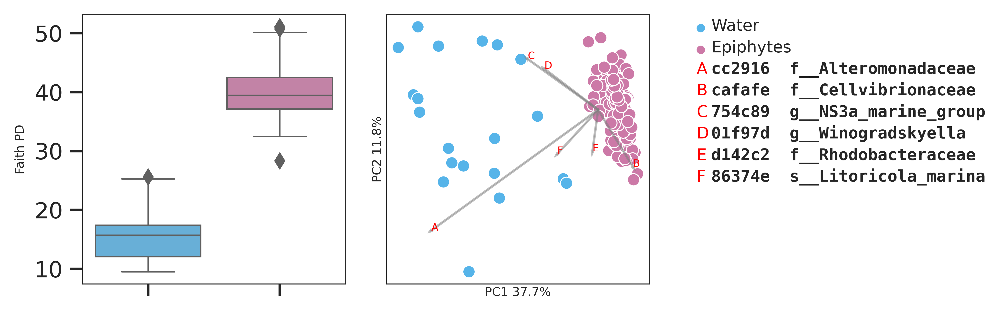

In [33]:
qza = 'DIVERSITY_epiphytes_and_water/weighted_unifrac_bplot_results.qza'
ordination, biplot, Eigvals, Proportion = parse_biplot(qza)

df = pd.concat([ordination,metadata.loc[ordination.index,:]],axis=1)
df.columns = [str(i) for i in df.columns]

fig, axes  = plt.subplots(ncols=3, dpi=600, figsize=(7,2.3), tight_layout=True)

ax = axes[0]

sns.boxplot(x='Fraction',y='faith_pd',data=faithpd,order=['water','epiphyte'],palette=['#56b4e9','#cc79a7'],ax=ax)
ax.legend().remove()
ax.set_ylabel('Faith PD',fontdict={'fontsize': 6})
ax.set_xlabel('')
ax.set_xticklabels([])

ax = axes[1]

sns.scatterplot(x='1',y='2',hue='Fraction',data=df,ax=ax, hue_order=['water','epiphyte'],palette=['#56b4e9','#cc79a7'], legend=False)
ylim = ax.get_ylim()
xlim = ax.get_xlim()

arrow_data = get_arrow_coords(1,2,6,biplot)
arrow_labels_legend = {}

letter = 'a'
for arrow in arrow_data:
    arrow_x,text_x = arrow[1]*0.5,arrow[1]*0.5
    arrow_y, text_y = arrow[2]*0.5, arrow[2]*0.5

    ax.arrow(0, 0, arrow_x, arrow_y, fc='gray',ec='gray',alpha=0.5)
    
    asv = taxa.at[arrow[0],'Taxon']
    
    taxline = asv.split(';')
    tax = taxline.pop(-1)
    while 'Unknown' in tax or 'uncultured' in tax or tax == '__' or 'bacterium' in tax:
        tax = taxline.pop(-1)
    #tax = tax.split('_')[-1]
    
    arrow_labels_legend[letter.upper()] = arrow[0][:6] + ' ' + tax
    ax.text(text_x, text_y, letter.upper(), fontdict={'fontsize': 5, 'color':'red'})
    letter = chr(ord(letter) + 1)

ax.tick_params(axis='both', length=0, pad=0)       
ax.set_xticklabels([])
ax.set_yticklabels([])
ax.set_xlabel('PC%i %.1f%%' % (1, Proportion[0]*100.0),fontdict={'fontsize': 6})
ax.set_ylabel('PC%i %.1f%%' % (2, Proportion[1]*100.0),fontdict={'fontsize': 6})
ax.xaxis.set_label_coords(0.5, -0.01)
ax.yaxis.set_label_coords(-0.01, 0.5)
ax.autoscale(enable=True, axis='both', tight=None) 

ax = axes[2]
ax.tick_params(axis='both', length=0, pad=0)       
ax.set_xticklabels([])
ax.set_yticklabels([])
ax.set_ylim(0,1)
ax.set_xlim(0,0.25)

legend = sorted(list(arrow_labels_legend.items()))
y = 0.95
a = {'Water': '#56b4e9', 'Epiphytes':'#cc79a7'}
for m in a:
    sns.scatterplot([0.01],[y],color=a[m],ax=ax,s=20,legend=False)
    ax.text(0.02,y-0.01,m,fontdict={'size':8})
    y -= 0.08

for i in legend:
    ax.text(0.006,y-0.01,i[0],fontdict={'size':8,'color':'red'})
    asv = i[1]
    ax.text(0.02,y-0.01,asv,fontdict={'size':8,'family':'monospace','weight':'semibold'})
    y -= 0.08

for a in ['top','bottom','left','right']:
    ax.spines[a].set_visible(False)
    
fig.savefig('Figures/FigS2.png',bbox_inches='tight')

**Diversity, epiphytes**

In [27]:
depth=4000

!qiime diversity core-metrics-phylogenetic \
  --i-phylogeny dada/rooted-tree.qza \
  --i-table ./dada/table.epiphyte.no_water.qza \
  --p-sampling-depth $depth \
  --m-metadata-file metadata.tsv \
  --output-dir DIVERSITY_epiphytes

Saved FeatureTable[Frequency] to: DIVERSITY_epiphytes/rarefied_table.qza
Saved SampleData[AlphaDiversity] to: DIVERSITY_epiphytes/faith_pd_vector.qza
Saved SampleData[AlphaDiversity] to: DIVERSITY_epiphytes/observed_features_vector.qza
Saved SampleData[AlphaDiversity] to: DIVERSITY_epiphytes/shannon_vector.qza
Saved SampleData[AlphaDiversity] to: DIVERSITY_epiphytes/evenness_vector.qza
Saved DistanceMatrix to: DIVERSITY_epiphytes/unweighted_unifrac_distance_matrix.qza
Saved DistanceMatrix to: DIVERSITY_epiphytes/weighted_unifrac_distance_matrix.qza
Saved DistanceMatrix to: DIVERSITY_epiphytes/jaccard_distance_matrix.qza
Saved DistanceMatrix to: DIVERSITY_epiphytes/bray_curtis_distance_matrix.qza
Saved PCoAResults to: DIVERSITY_epiphytes/unweighted_unifrac_pcoa_results.qza
Saved PCoAResults to: DIVERSITY_epiphytes/weighted_unifrac_pcoa_results.qza
Saved PCoAResults to: DIVERSITY_epiphytes/jaccard_pcoa_results.qza
Saved PCoAResults to: DIVERSITY_epiphytes/bray_curtis_pcoa_results.qza
Sav

In [35]:
qza = 'DIVERSITY_epiphytes/faith_pd_vector.qza'
a = !unzip $qza
digest = a[1].split('/')[0].replace('  inflating: ','')
inf = digest + '/data/alpha-diversity.tsv'
faithpd = pd.read_csv(inf,index_col=0,sep='\t')
!rm -r $digest

metadata = pd.read_csv('metadata.tsv',sep='\t',index_col=0)
def get_treatment(string):
    return metadata.at[string,'Treatment']
def get_site(string):
    return metadata.at[string,'SourceSite']
def get_tp(string):
    return metadata.at[string,'T']
def get_t(string):
    return {0:0,3:1,5:2,8:3}[metadata.at[string,'TP']]

faithpd['Treatment'] = faithpd.index.map(get_treatment)
faithpd['SourceSite'] = faithpd.index.map(get_site)
faithpd['TP'] = faithpd.index.map(get_tp)
faithpd['t'] = faithpd.index.map(get_t)
faithpd.index.name = 'sample-id'
faithpd.to_csv('DIVERSITY_epiphytes/faithpd_anova.tsv',sep='\t')

!qiime longitudinal anova \
    --m-metadata-file DIVERSITY_epiphytes/faithpd_anova.tsv \
    --p-formula "faith_pd ~ Treatment + SourceSite + TP" \
    --o-visualization DIVERSITY_epiphytes/faithpd_anova.qzv

Saved Visualization to: DIVERSITY_epiphytes/faithpd_anova.qzv


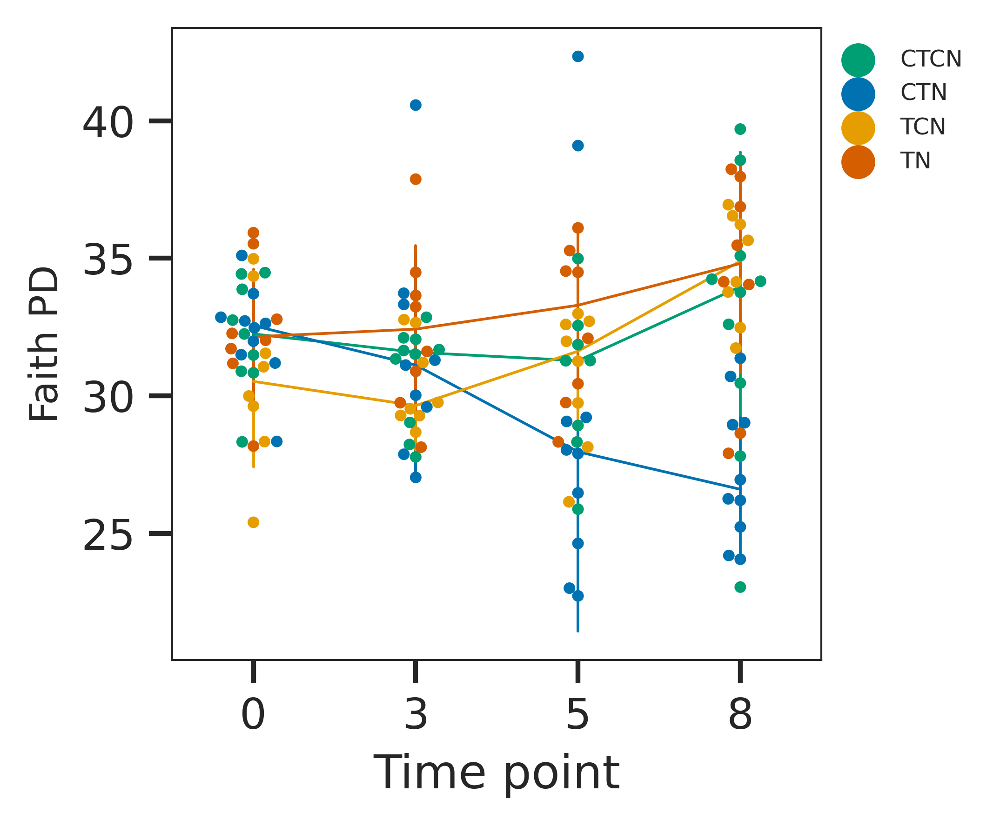

In [37]:
fig, ax = plt.subplots(dpi=600, figsize=(3,3))

pal={'CTCN':'#009e73','CTN':'#0072b2','TCN':'#e69d00','TN':'#d55e00'}

#sns.boxplot(x='t',y='faith_pd',data=faithpd,order=[0,3,5,8], color='w',ax=ax)
sns.swarmplot(x='t',y='faith_pd',data=faithpd, hue='Treatment',ax=ax,palette=pal,size=3)
sns.lineplot(x='t',y='faith_pd',data=faithpd,hue='Treatment',ax=ax,palette=pal,ci='sd',err_style='bars',legend=False,estimator="median")
ax.legend(loc=1,bbox_to_anchor=(1.25,1),fontsize=6,frameon=False)
ax.set_ylabel('Faith PD',fontdict={'fontsize': 10})
ax.set_xlabel('Time point')
ax.set_xticklabels(['0','3','5','8'])
fig.savefig('Figures/Fig3.png',bbox_inches='tight')

In [38]:
for t in ['0tp','3tp','5tp','8tp']:
    
    depth=4000
    
    table = 'dada/table.%s.qza' % t
    outf = 'DIVERSITY_epiphytes/%s/' % t

    !qiime diversity core-metrics-phylogenetic \
      --i-phylogeny dada/rooted-tree.qza \
      --i-table $table \
      --p-sampling-depth $depth \
      --m-metadata-file metadata.tsv \
      --output-dir $outf
    
    for unifrac in ['weighted','unweighted']:
        
        matrix = outf + '%s_unifrac_distance_matrix.qza' % unifrac
        pcoa = outf + '%s_unifrac_pcoa_results.qza' % unifrac
        rare = outf + 'rarefied_table.qza'
        biplot = outf + '%s_unifrac_biplot_results.qza' % unifrac
    
        !qiime diversity pcoa \
          --i-distance-matrix $matrix \
          --p-number-of-dimensions 3 \
          --o-pcoa $pcoa

        !qiime feature-table relative-frequency \
          --i-table $rare \
          --o-relative-frequency-table temp.qza

        !qiime diversity pcoa-biplot \
          --i-pcoa $pcoa \
          --i-features temp.qza \
          --o-biplot $biplot

Saved FeatureTable[Frequency] to: DIVERSITY_epiphytes/0tp/rarefied_table.qza
Saved SampleData[AlphaDiversity] to: DIVERSITY_epiphytes/0tp/faith_pd_vector.qza
Saved SampleData[AlphaDiversity] to: DIVERSITY_epiphytes/0tp/observed_features_vector.qza
Saved SampleData[AlphaDiversity] to: DIVERSITY_epiphytes/0tp/shannon_vector.qza
Saved SampleData[AlphaDiversity] to: DIVERSITY_epiphytes/0tp/evenness_vector.qza
Saved DistanceMatrix to: DIVERSITY_epiphytes/0tp/unweighted_unifrac_distance_matrix.qza
Saved DistanceMatrix to: DIVERSITY_epiphytes/0tp/weighted_unifrac_distance_matrix.qza
Saved DistanceMatrix to: DIVERSITY_epiphytes/0tp/jaccard_distance_matrix.qza
Saved DistanceMatrix to: DIVERSITY_epiphytes/0tp/bray_curtis_distance_matrix.qza
Saved PCoAResults to: DIVERSITY_epiphytes/0tp/unweighted_unifrac_pcoa_results.qza
Saved PCoAResults to: DIVERSITY_epiphytes/0tp/weighted_unifrac_pcoa_results.qza
Saved PCoAResults to: DIVERSITY_epiphytes/0tp/jaccard_pcoa_results.qza
Saved PCoAResults to: DIVE

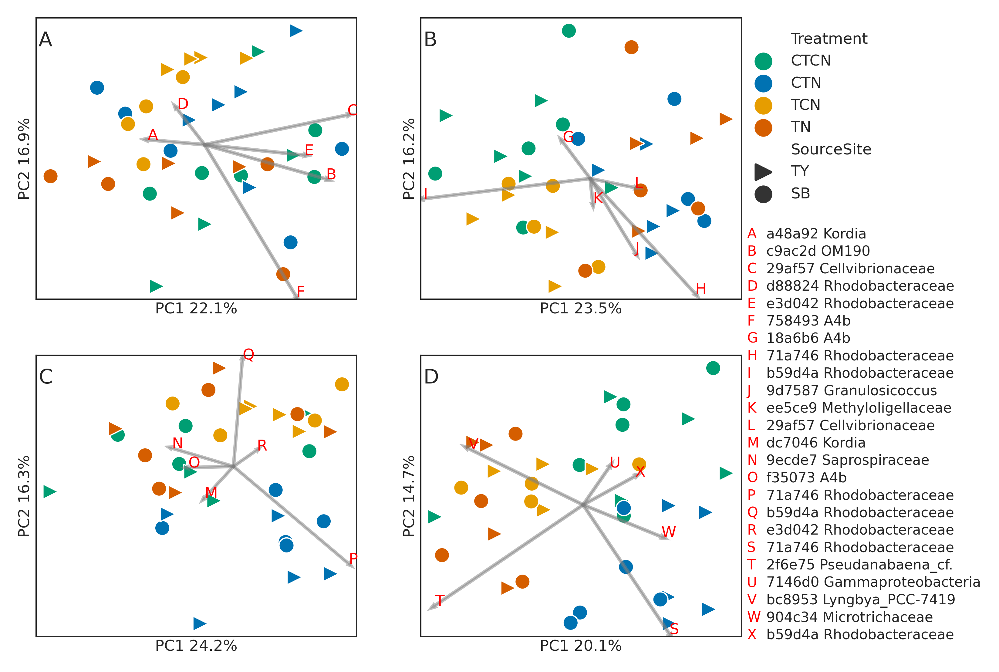

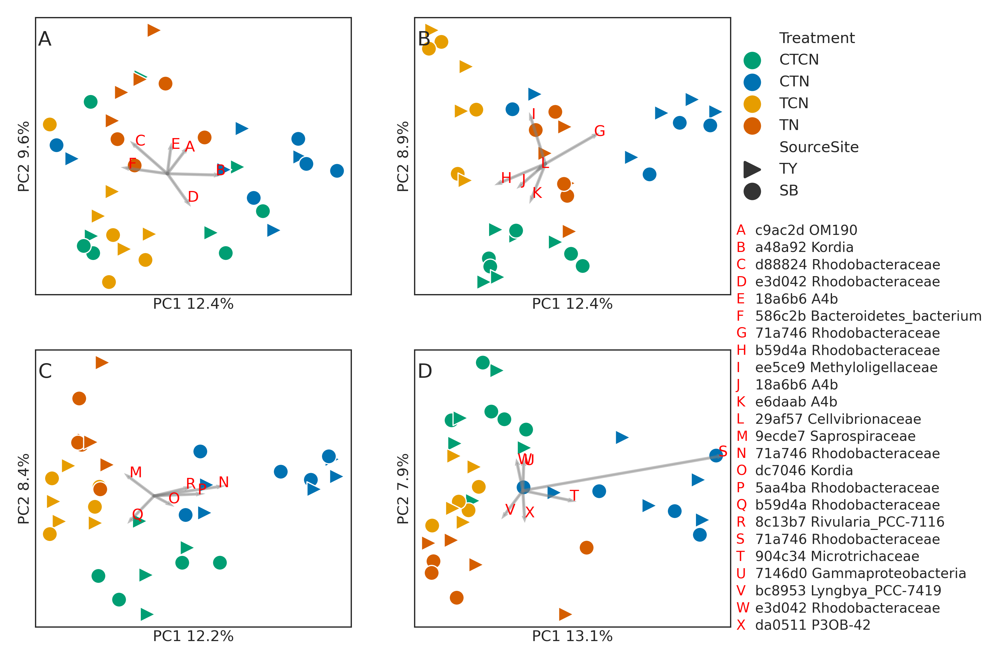

In [43]:
pal={'CTCN':'#009e73','CTN':'#0072b2','TCN':'#e69d00','TN':'#d55e00'}
shape = {'SB':'o','TY':'>'}
taxa = Artifact.load('dada/taxonomy.qza').view(pd.DataFrame)
metadata = pd.read_csv('metadata.tsv',sep='\t',index_col=0)

keep_important_taxa = set()

for unifrac in ['weighted','unweighted']:
    
    arrow_labels_legend = {}
    letter = 'a'
    ax_labels = ['A','B','C','D']
    
    tps = ['0tp','3tp','5tp','8tp']
    fig, axes = plt.subplots(nrows=2,ncols=2,dpi=600, figsize=(5,4.5))
    
    for row in axes:
        for ax in row:
            legend = False
            tp = tps.pop(0)
            if tp == '3tp':
                legend=True

            qza = 'DIVERSITY_epiphytes/%s/%s_unifrac_biplot_results.qza' % (tp,unifrac)
            ordination, biplot, Eigvals, Proportion = parse_biplot(qza)

            df = pd.concat([ordination,metadata.loc[ordination.index,:]],axis=1)
            df.columns = [str(i) for i in df.columns]
            
            sns.scatterplot(x='1',y='2',hue='Treatment',data=df,ax=ax, palette=pal,
                            style='SourceSite', markers=shape, legend=legend)
            if tp == '3tp':
                ax.legend(loc=1,bbox_to_anchor=(1.45,1),fontsize=6,frameon=False)
             
            ylim = ax.get_ylim()
            xlim = ax.get_xlim()

            arrow_data = get_arrow_coords(1,2,6,biplot)

            for arrow in arrow_data:
                arrow_x,text_x = arrow[1]*0.7,arrow[1]*0.7
                arrow_y, text_y = arrow[2]*0.7, arrow[2]*0.7
                
                if arrow_x < xlim[0] or arrow_x > xlim[1]:
                    arrow_x = arrow_x * 0.15
                    text_x = arrow_x
                
                if arrow_y < ylim[0] or arrow_y > ylim[1]:
                    arrow_y = arrow_y * 0.15
                    text_y = arrow_y

                ax.arrow(0, 0, arrow_x, arrow_y, fc='gray',ec='gray',alpha=0.5)

                asv = taxa.at[arrow[0],'Taxon']

                taxline = asv.split(';')
                tax = taxline.pop(-1)
                while 'Unknown' in tax or 'uncultured' in tax or tax == '__' in tax:
                    tax = taxline.pop(-1)
                tax = tax.split('__')[1]

                arrow_labels_legend[letter.upper()] = arrow[0][:6] + ' ' + tax
                keep_important_taxa.add(arrow[0][:6] + ' ' + tax)
                ax.text(text_x, text_y, letter.upper(), fontdict={'fontsize': 6, 'color':'red'})
                letter = chr(ord(letter) + 1)
                
            ax.annotate(ax_labels.pop(0),xy=(0,1),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=8)
            
            ax.tick_params(axis='both', length=0, pad=0)       
            ax.set_xticklabels([])
            ax.set_yticklabels([])
            ax.set_xlabel('PC%i %.1f%%' % (1, Proportion[0]*100.0),fontdict={'fontsize': 6})
            ax.set_ylabel('PC%i %.1f%%' % (2, Proportion[1]*100.0),fontdict={'fontsize': 6})
            ax.xaxis.set_label_coords(0.5, -0.01)
            ax.yaxis.set_label_coords(-0.01, 0.5)
            ax.autoscale(enable=True, axis='both', tight=None)
            
            
    y = 1.5
    ax = axes[1][1]
    for i in arrow_labels_legend.items():
        ax.annotate(i[0],xy=(1.01,y),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=5.5,color='red')
        ax.annotate(i[1],xy=(1.07,y),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=5.5)
        y -= 0.062

    if unifrac == 'weighted':
        fig.savefig('Figures/FigS3.png', bbox_inches='tight')

    elif unifrac == 'unweighted':
        fig.savefig('Figures/Fig4.png', bbox_inches='tight')

### Notes

<pre>

The bacteria that increase in CTN and reduce alpha diversity there:

ASV 71a746 responsible for the reduction in alpha diversity in CTN is most closely related to AM691091, an extremophile from the East German Creek system in Canada (https://pubmed.ncbi.nlm.nih.gov/18385928/).  
It clusters within Roseobacter, which contains temprate and polar spcieces (https://paperpile.com/shared/fpC3qq), and was first descibed in seaweed (https://paperpile.com/shared/TZV1LP).
Some reduce NO3 to NO2 (https://paperpile.com/shared/HjQQia), which is consistent with the NO2 measurements, which had two to three times higher average concentrations in CTN.
(https://paperpile.com/shared/wX94NJ):"Use  of  a  multitude  of  organic  compounds,  sul-fur    oxidation,    aerobic    anoxygenic    photosynthesis,    oxida-tion      of      carbon      monoxide,      
DMSP      demethylation,      andproduction  of  secondary  metabolites  are  some  of  the  impor-tant  traits  found  in  this  clad"  

Microtrichaceae  (the tree is not informative)
Was found to be highly abundant in a partial nitrification - anamox system, were partial nitrification produces NO2, which is then used by Microtrichaceae to oxydize NH4+ (https://paperpile.com/shared/iX2pIM).  

Temp recovery accompnied by incompleate nutrient recovery promotes the increase in bc8953 Lyngbya and Pseudanabaena 2f6e75, toxic bloom forming cyanobacteria
(https://paperpile.com/shared/fyw3nS):"Therefore, when Lyngbya majuscula blooms occur, light limitation is one of the mechanisms altering H. wrightii density and leaf lengths in the IRL. Loss of H. wrightii 
    biomass due to shading from cyanobacterial mats may further damage the diversity and habitat value of the IRL."
(https://paperpile.com/shared/NfjU2N): Pseudanabaena
    
Unidentified Gammaproteobacteria (7146d0) are displaced compared to the control in recovery.

When considering unweighted distances teh control samples diverge from all the treatment samples at time point 3.
The treatment samples lose J and K which are A4b (18a6b6,e6daab) but this is no longer a distinction following recovery, so they recover. 
They are closely related to facultative anaerobe chloroflexi isolated from the Guerrero Negro hypersaline microbial mat (https://paperpile.com/shared/U8F2yd) according to phylogenetic tree

</pre>

In [32]:
from Bio import SeqIO
from gzip import open as gopen

!mkdir phylogenies

#!wget https://www.arb-silva.de/fileadmin/silva_databases/current/Exports/SILVA_138.1_SSURef_NR99_tax_silva.fasta.gz
!zcat SILVA_138.1_SSURef_NR99_tax_silva.fasta.gz | makeblastdb -title silva -out silva -dbtype nucl

qza = 'dada/rep-seqs.qza'
a = !unzip $qza
digest = a[1].split('/')[0].replace('  inflating: ','')
inf = digest + '/data/dna-sequences.fasta'
ASVs = SeqIO.to_dict(SeqIO.parse(inf,'fasta'))
!rm -r $digest

from gzip import open as gopen
refs = SeqIO.to_dict(SeqIO.parse(gopen('SILVA_138.1_SSURef_NR99_tax_silva.fasta.gz','rt'),'fasta'))

for x in keep_important_taxa:

    taxon = x.replace(' ','_')
    query = None
    for rid in ASVs:
        if rid.startswith(x.split()[0]):
            query = rid
            break

    with open('phylogenies/%s.fasta' % taxon,'wt') as hndl:
        for ind in [query]:
            hndl.write(ASVs[ind].format('fasta'))

    blastin = 'phylogenies/%s.fasta' % taxon
    blastout = 'phylogenies/%s.out' % taxon

    a = !blastn -query $blastin -out $blastout -outfmt 6 -max_hsps 1 -max_target_seqs 50 -db silva


    blast = pd.read_csv(blastout,sep='\t',header=None)
    blast =set([i for i in blast[1]])

    alnin = 'phylogenies/%s_with_refs.fasta' % taxon

    with open(alnin,'wt') as hndl:
        for i in blast:
            hndl.write(refs[i].format('fasta'))
        hndl.write(open(blastin,'r').read())

    alnout = 'phylogenies/%s_with_refs.aln.fasta' % taxon
    a = !mafft --maxiterate 1000 --localpair --thread 14 $alnin > $alnout

    trimout = 'phylogenies/%s_with_refs.trm.fasta' % taxon
    a = !trimal -in $alnout -out $trimout -gt 0.1
    a = !raxmlHPC-PTHREADS -s $trimout -f a -x 123 -N 100 -n $taxon -m GTRGAMMA -p 456 -T 10 -w /home/amir/Dropbox/DropboxOnBioPC91/SeaGrass/phylogenies

mkdir: cannot create directory ‘phylogenies’: File exists


Building a new DB, current time: 03/03/2021 09:44:18
New DB name:   /home/amir/Dropbox/DropboxOnBioPC91/SeaGrass/silva
New DB title:  silva
Sequence type: Nucleotide
Keep MBits: T
Maximum file size: 1000000000B
Adding sequences from FASTA; added 510508 sequences in 18.0389 seconds.




In [2]:
from ete3 import Tree, TextFace, CircleFace, NodeStyle, TreeStyle
from gzip import open as gopen
from Bio import Entrez, SeqIO
from time import sleep
from os import path
import glob
Entrez.email = "amir@adssc.org"

refs = SeqIO.to_dict(SeqIO.parse(gopen('SILVA_138.1_SSURef_NR99_tax_silva.fasta.gz','rt'),'fasta'))

for f in glob.glob('phylogenies/RAxML_bipartitions.*'):
    taxon = f.split('.')[-1]
    if path.exists('phylogenies/%s.png' % taxon):
        continue
    t = Tree(f)

    ns = NodeStyle()
    ns['size'] = 0

    t.set_outgroup(t.get_midpoint_outgroup())
    for n in t.traverse():
        n.set_style(ns)
        if n.is_leaf():
            if n.name in refs:
                color = 'black'
                desc =   refs[n.name].description.split(';')[-1]
                if desc.startswith(taxon):
                    color='blue'
                n.add_face(TextFace(n.name + ' ',fgcolor='black'),0,position='branch-right')
                n.add_face(TextFace(desc,fgcolor=color),1,position='branch-right')
                handle = Entrez.efetch(db="nucleotide", id=n.name.split('.')[0], rettype="gb", retmode="text")
                sleep(1)
                r = SeqIO.read(handle,'gb')
                handle.close()
                if 'isolation_source' in r.features[0].qualifiers:
                    source = r.features[0].qualifiers['isolation_source'][0]
                    n.add_face(TextFace(' '+source,fgcolor='green'),2,position='branch-right')
            else:
                n.add_face(TextFace(taxon+' '+n.name[:6],fgcolor='red'),0,position='branch-right')
        elif n.support > 70:
            n.add_face(CircleFace(4,'black'),0,position='float')

    ts = TreeStyle()
    ts.show_leaf_name = False
    ts.scale=2000

    t.render('phylogenies/%s.png' % taxon, tree_style=ts,dpi=600,w=1500)            

In [181]:
!mkdir ancom_treatments_family

!qiime taxa collapse \
  --i-table DIVERSITY_epiphytes/rarefied_table.qza \
  --i-taxonomy dada/taxonomy.qza \
  --p-level 5 \
  --o-collapsed-table DIVERSITY_epiphytes/rarefied_table.l5.qza

treatments = ['CTCN','CTN','TCN','TN']

metadata = pd.read_csv('metadata.tsv',sep='\t',index_col=0)

table_ids = Artifact.load('DIVERSITY_epiphytes/rarefied_table.l5.qza').view(pd.DataFrame).index.tolist()

for i in range(4):
    for j in range(i+1,4):
        a = treatments[i]
        b = treatments[j]
        outf = 'ancom_treatments_family/%s-%s.qzv' % (a,b)
        samples = metadata.loc[metadata.Treatment.isin([a,b])].index
        with open('temp','wt') as hndl:
            hndl.write('sample-id\n')
            for ind in samples:
                if ind not in table_ids:
                    continue
                hndl.write('%s\n' % ind)
        !qiime feature-table filter-samples \
          --i-table DIVERSITY_epiphytes/rarefied_table.l5.qza \
          --m-metadata-file temp \
          --o-filtered-table temp.qza
        
        !qiime composition add-pseudocount \
          --i-table temp.qza \
          --o-composition-table temp.qza

        !qiime composition ancom \
          --i-table temp.qza \
          --m-metadata-file metadata.tsv \
          --m-metadata-column Treatment \
          --o-visualization $outf
        
        for tp in [0,3,5,8]:
            outf = 'ancom_treatments_family/%s-%s-tp%i.qzv' % (a,b,tp)
            samples = metadata.loc[(metadata.Treatment.isin([a,b])&(metadata.TP==tp))].index
            with open('temp','wt') as hndl:
                hndl.write('sample-id\n')
                for ind in samples:
                    if ind not in table_ids:
                        continue
                    hndl.write('%s\n' % ind)
            !qiime feature-table filter-samples \
              --i-table DIVERSITY_epiphytes/rarefied_table.l5.qza \
              --m-metadata-file temp \
              --o-filtered-table temp.qza

            !qiime composition add-pseudocount \
              --i-table temp.qza \
              --o-composition-table temp.qza

            !qiime composition ancom \
              --i-table temp.qza \
              --m-metadata-file metadata.tsv \
              --m-metadata-column Treatment \
              --o-visualization $outf

Saved FeatureTable[Frequency] to: DIVERSITY_epiphytes/rarefied_table.l5.qza
Saved FeatureTable[Frequency] to: temp.qza
Saved FeatureTable[Composition] to: temp.qza
Saved Visualization to: ancom_treatments_family/CTCN-CTN.qzv
Saved FeatureTable[Frequency] to: temp.qza
Saved FeatureTable[Composition] to: temp.qza
Saved Visualization to: ancom_treatments_family/CTCN-CTN-tp0.qzv
Saved FeatureTable[Frequency] to: temp.qza
Saved FeatureTable[Composition] to: temp.qza
Saved Visualization to: ancom_treatments_family/CTCN-CTN-tp3.qzv
Saved FeatureTable[Frequency] to: temp.qza
Saved FeatureTable[Composition] to: temp.qza
Saved Visualization to: ancom_treatments_family/CTCN-CTN-tp5.qzv
Saved FeatureTable[Frequency] to: temp.qza
Saved FeatureTable[Composition] to: temp.qza
Saved Visualization to: ancom_treatments_family/CTCN-CTN-tp8.qzv
Saved FeatureTable[Frequency] to: temp.qza
Saved FeatureTable[Composition] to: temp.qza
Saved Visualization to: ancom_treatments_family/CTCN-TCN.qzv
Saved FeatureT

In [180]:
!mkdir ancom_treatments_order

!qiime taxa collapse \
  --i-table DIVERSITY_epiphytes/rarefied_table.qza \
  --i-taxonomy dada/taxonomy.qza \
  --p-level 4 \
  --o-collapsed-table DIVERSITY_epiphytes/rarefied_table.l4.qza

treatments = ['CTCN','CTN','TCN','TN']

metadata = pd.read_csv('metadata.tsv',sep='\t',index_col=0)

table_ids = Artifact.load('DIVERSITY_epiphytes/rarefied_table.l4.qza').view(pd.DataFrame).index.tolist()

for i in range(4):
    for j in range(i+1,4):
        a = treatments[i]
        b = treatments[j]
        outf = 'ancom_treatments_order/%s-%s.qzv' % (a,b)
        samples = metadata.loc[metadata.Treatment.isin([a,b])].index
        with open('temp','wt') as hndl:
            hndl.write('sample-id\n')
            for ind in samples:
                if ind not in table_ids:
                    continue
                hndl.write('%s\n' % ind)
        !qiime feature-table filter-samples \
          --i-table DIVERSITY_epiphytes/rarefied_table.l4.qza \
          --m-metadata-file temp \
          --o-filtered-table temp.qza
        
        !qiime composition add-pseudocount \
          --i-table temp.qza \
          --o-composition-table temp.qza

        !qiime composition ancom \
          --i-table temp.qza \
          --m-metadata-file metadata.tsv \
          --m-metadata-column Treatment \
          --o-visualization $outf
        
        for tp in [0,3,5,8]:
            outf = 'ancom_treatments_order/%s-%s-tp%i.qzv' % (a,b,tp)
            samples = metadata.loc[(metadata.Treatment.isin([a,b])&(metadata.TP==tp))].index
            with open('temp','wt') as hndl:
                hndl.write('sample-id\n')
                for ind in samples:
                    if ind not in table_ids:
                        continue
                    hndl.write('%s\n' % ind)
            !qiime feature-table filter-samples \
              --i-table DIVERSITY_epiphytes/rarefied_table.l4.qza \
              --m-metadata-file temp \
              --o-filtered-table temp.qza

            !qiime composition add-pseudocount \
              --i-table temp.qza \
              --o-composition-table temp.qza

            !qiime composition ancom \
              --i-table temp.qza \
              --m-metadata-file metadata.tsv \
              --m-metadata-column Treatment \
              --o-visualization $outf

Saved FeatureTable[Frequency] to: DIVERSITY_epiphytes/rarefied_table.l4.qza
Saved FeatureTable[Frequency] to: temp.qza
Saved FeatureTable[Composition] to: temp.qza
Saved Visualization to: ancom_treatments/CTCN-CTN.qzv
Saved FeatureTable[Frequency] to: temp.qza
Saved FeatureTable[Composition] to: temp.qza
Saved Visualization to: ancom_treatments/CTCN-CTN-tp0.qzv
Saved FeatureTable[Frequency] to: temp.qza
Saved FeatureTable[Composition] to: temp.qza
Saved Visualization to: ancom_treatments/CTCN-CTN-tp3.qzv
Saved FeatureTable[Frequency] to: temp.qza
Saved FeatureTable[Composition] to: temp.qza
Saved Visualization to: ancom_treatments/CTCN-CTN-tp5.qzv
Saved FeatureTable[Frequency] to: temp.qza
Saved FeatureTable[Composition] to: temp.qza
Saved Visualization to: ancom_treatments/CTCN-CTN-tp8.qzv
Saved FeatureTable[Frequency] to: temp.qza
Saved FeatureTable[Composition] to: temp.qza
Saved Visualization to: ancom_treatments/CTCN-TCN.qzv
Saved FeatureTable[Frequency] to: temp.qza
Saved Feature

rm: cannot remove 'temp.qza': No such file or directory


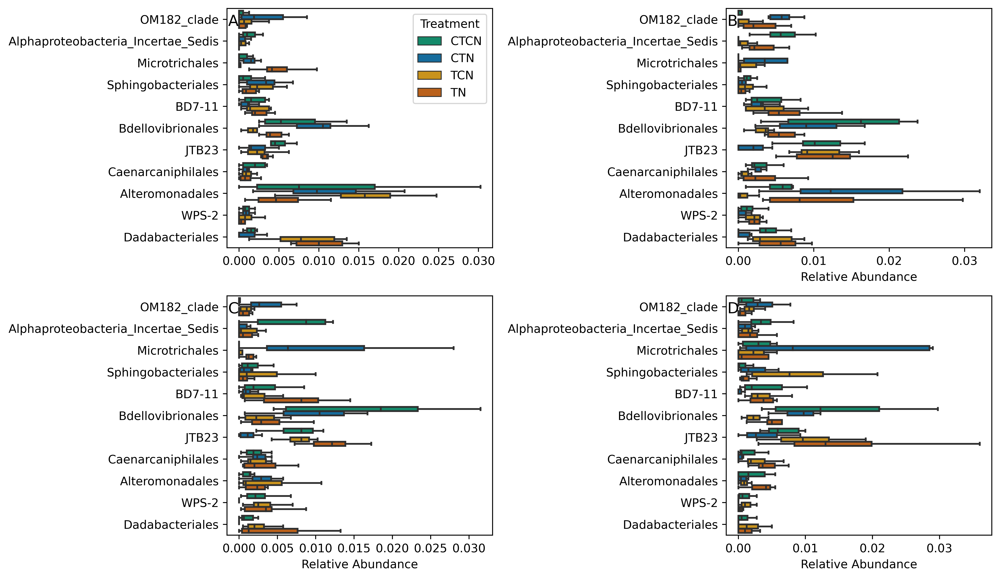

In [687]:
ancom_orders = """d__Bacteria;p__Proteobacteria;c__Gammaproteobacteria;o__OM182_clade
d__Bacteria;p__Proteobacteria;c__Alphaproteobacteria;o__Alphaproteobacteria_Incertae_Sedis
d__Bacteria;p__Actinobacteriota;c__Acidimicrobiia;o__Microtrichales
d__Bacteria;p__Bacteroidota;c__Bacteroidia;o__Sphingobacteriales
d__Bacteria;p__Planctomycetota;c__BD7-11;o__BD7-11
d__Bacteria;p__Bdellovibrionota;c__Bdellovibrionia;o__Bdellovibrionales
d__Bacteria;p__Proteobacteria;c__Gammaproteobacteria;o__JTB23
d__Bacteria;p__Cyanobacteria;c__Vampirivibrionia;o__Caenarcaniphilales
d__Bacteria;p__Proteobacteria;c__Gammaproteobacteria;o__Alteromonadales
d__Bacteria;p__WPS-2;c__WPS-2;o__WPS-2
d__Bacteria;p__Dadabacteria;c__Dadabacteriia;o__Dadabacteriales""".splitlines()

narrow = pd.DataFrame(columns = ['taxon','order','Treatment','TP','SourceSite','Relative Abundance'])

metadata = pd.read_csv('metadata.tsv',sep='\t',index_col=0)
    
a = Artifact.load('DIVERSITY_epiphytes/rarefied_table.l4.qza')
table = a.view(pd.DataFrame)
table = table.div(table.sum(axis=1), axis=0)

table = table.transpose()

table = table.loc[ancom_orders,:]

for taxon in table.index.tolist():
    for col in table:
        treatment = metadata.at[col,'Treatment']
        tp = metadata.at[col,'TP']
        site = metadata.at[col,'SourceSite']
        narrow.loc[len(narrow)] = [taxon,taxon.split('__')[-1],treatment,tp,site,table.at[taxon,col]]

!rm temp.qza

fig, axes = plt.subplots(nrows = 2, ncols=2, dpi=600, figsize=(12,7),tight_layout=True)
ax_labels = ['A','B','C','D']
timepoints = [0,3,5,8]

for row in axes:
    for ax in row:
        
        tp = timepoints.pop(0)

        a = narrow.loc[narrow.TP==tp]

        a.pivot_table(index=['order','Treatment'])

        sns.boxplot(x='Relative Abundance',y='order',data=a,hue='Treatment',hue_order=['CTCN','CTN','TCN','TN'],
                      ax=ax,palette=['#009e73','#0072b2','#e69d00','#d55e00'],showfliers=False)

        if len(ax_labels) < 4:
            ax.legend().remove()
        else:
            ax.set_xlabel('')

        ax.set_ylabel('')
        ax.annotate(ax_labels.pop(0),xy=(0,1),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)

        
#plt.savefig('ancom_orders.png',bbox_inches='tight')

/home/amir/anaconda3/envs/qiime2-2020.11/lib/python3.6/site-packages/ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  del sys.path[0]


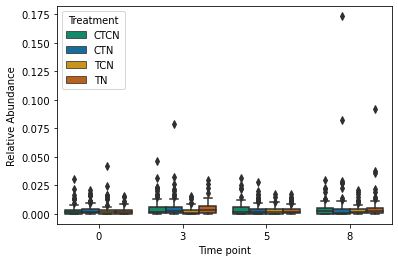

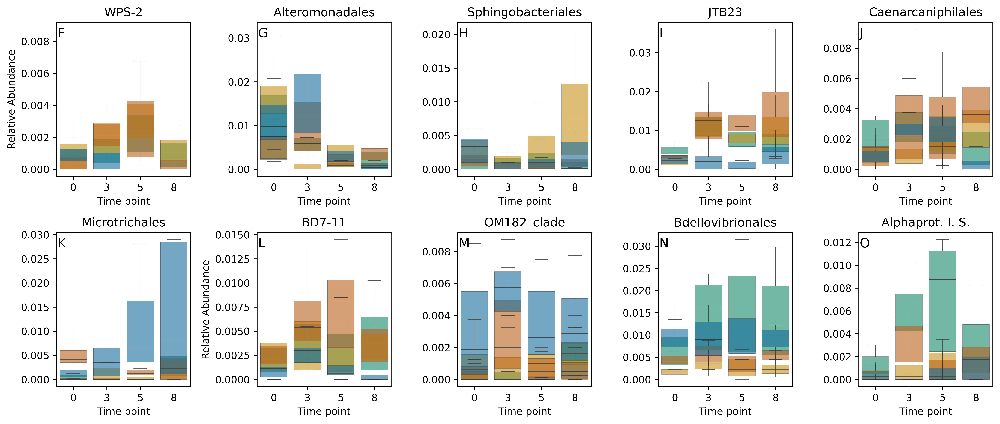

In [690]:
ancom_orders = """d__Bacteria;p__Proteobacteria;c__Gammaproteobacteria;o__OM182_clade
d__Bacteria;p__Proteobacteria;c__Alphaproteobacteria;o__Alphaproteobacteria_Incertae_Sedis
d__Bacteria;p__Actinobacteriota;c__Acidimicrobiia;o__Microtrichales
d__Bacteria;p__Bacteroidota;c__Bacteroidia;o__Sphingobacteriales
d__Bacteria;p__Planctomycetota;c__BD7-11;o__BD7-11
d__Bacteria;p__Bdellovibrionota;c__Bdellovibrionia;o__Bdellovibrionales
d__Bacteria;p__Proteobacteria;c__Gammaproteobacteria;o__JTB23
d__Bacteria;p__Cyanobacteria;c__Vampirivibrionia;o__Caenarcaniphilales
d__Bacteria;p__Proteobacteria;c__Gammaproteobacteria;o__Alteromonadales
d__Bacteria;p__WPS-2;c__WPS-2;o__WPS-2""".splitlines()

a = narrow.loc[(narrow.order.isin([i.split('__')[-1] for i in ancom_orders]))]
a['Time point'] = a.TP.astype(int)
fig, j =plt.subplots()
sns.boxplot(x='Time point',y='Relative Abundance',data=a, hue='Treatment',palette=['#009e73','#0072b2','#e69d00','#d55e00'],ax = j)
handles, labels = j.get_legend_handles_labels()


fig, axes = plt.subplots(ncols=5, nrows=2,tight_layout=True, figsize=(14,6),dpi=600)

inds = [0,0,0,1,0,2,0,3,0,4,1,0,1,1,1,2,1,3,1,4]
ind=0

ax_labels = list("FGHIJKLMNOP")

for order in set(a.order):
    colors = ['#009e73','#e69d00','#d55e00','#0072b2']
    ax = axes[inds.pop(0)][inds.pop(0)]
    for treat in ['CTCN','TCN','TN','CTN']:
        
        sns.boxplot(x='Time point', linewidth=0.2,
                    y='Relative Abundance',
                    data=a.loc[((a.order==order)&(a.Treatment==treat))],
                    color=colors.pop(0),
                    ax=ax,
                    showfliers=False,boxprops=dict(alpha=.6))

    ax.annotate(ax_labels.pop(0),xy=(0,1),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)

    if ind != 0:
        ax.legend().remove()
    else:
        ax.legend().remove()
        #ax.legend(handles, labels, frameon=False,loc=0,bbox_to_anchor=(0.4,0.97))
    if ind not in [0,6]:
        ax.set_ylabel('')

    #bottom, top = ax.get_ylim()
    #for i in [0.5, 1.5, 2.5]:
    #    ax.axvline(x=i,ymin=0,ymax=1,color='orange')
    ax.set_title(order)
    if order.startswith('Alpha'):
        ax.set_title('Alphaprot. I. S.')
    
    ind += 1
    
fig.savefig('temp_figs/ancom_orders_boxplot.png',bbox_inches='tight')

In [49]:
ancom_orders = """d__Bacteria;p__Proteobacteria;c__Alphaproteobacteria;o__Alphaproteobacteria_Incertae_Sedis;f__Unknown_Family
d__Bacteria;p__Actinobacteriota;c__Acidimicrobiia;o__Microtrichales;f__Microtrichaceae
d__Bacteria;p__Cyanobacteria;c__Cyanobacteriia;o__Cyanobacteriales;f__Microcystaceae
d__Bacteria;p__Bacteroidota;c__Bacteroidia;o__Chitinophagales;f__uncultured
d__Bacteria;p__Bacteroidota;c__Bacteroidia;o__Sphingobacteriales;f__NS11-12_marine_group
d__Bacteria;p__Bacteroidota;c__Bacteroidia;o__Cytophagales;f__Microscillaceae
d__Bacteria;p__Cyanobacteria;c__Cyanobacteriia;o__Cyanobacteriales;f__Phormidiaceae
d__Bacteria;p__Proteobacteria;c__Gammaproteobacteria;o__Alteromonadales;f__Alteromonadaceae
d__Bacteria;p__Planctomycetota;c__Planctomycetes;o__Planctomycetales;f__Rubinisphaeraceae
d__Bacteria;p__Proteobacteria;c__Alphaproteobacteria;o__Tistrellales;f__Geminicoccaceae""".splitlines()

narrow = pd.DataFrame(columns = ['taxon','family','Treatment','TP','SourceSite','Relative Abundance'])

metadata = pd.read_csv('metadata.tsv',sep='\t',index_col=0)
    
a = Artifact.load('DIVERSITY_epiphytes/rarefied_table.l5.qza')
table = a.view(pd.DataFrame)
table = table.div(table.sum(axis=1), axis=0)

table = table.transpose()

table = table.loc[ancom_orders,:]

for taxon in table.index.tolist():
    for col in table:
        treatment = metadata.at[col,'Treatment']
        tp = metadata.at[col,'TP']
        site = metadata.at[col,'SourceSite']
        family = taxon.split('__')[-1]
        if family == 'Unknown_Family':
            family = 'Alphaproteobacteria_Incertae_Sedis family'
        if family == 'uncultured':
            family = 'Chitinophagales family'
        narrow.loc[len(narrow)] = [taxon,family,treatment,tp,site,table.at[taxon,col]]

!rm temp.qza

rm: cannot remove 'temp.qza': No such file or directory


rm: cannot remove 'temp.qza': No such file or directory


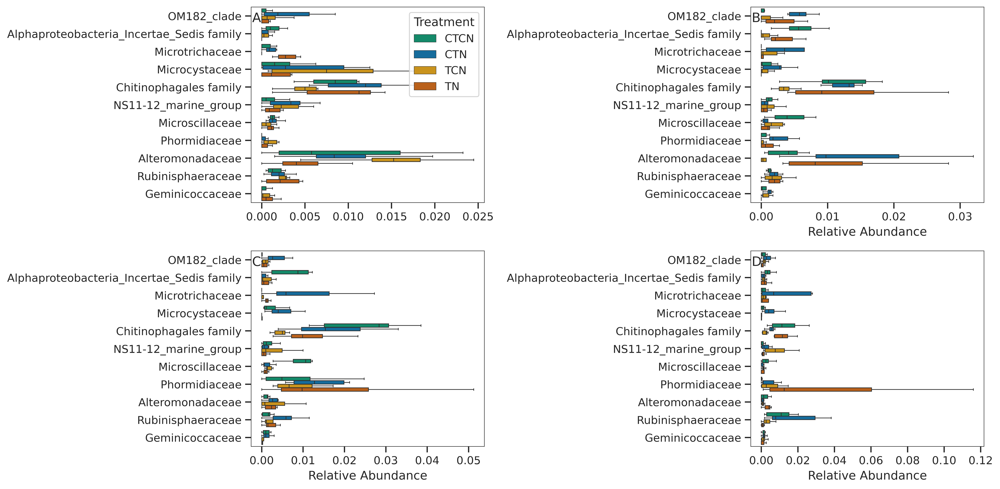

In [278]:
ancom_orders = """d__Bacteria;p__Proteobacteria;c__Gammaproteobacteria;o__OM182_clade;f__OM182_clade
d__Bacteria;p__Proteobacteria;c__Alphaproteobacteria;o__Alphaproteobacteria_Incertae_Sedis;f__Unknown_Family
d__Bacteria;p__Actinobacteriota;c__Acidimicrobiia;o__Microtrichales;f__Microtrichaceae
d__Bacteria;p__Cyanobacteria;c__Cyanobacteriia;o__Cyanobacteriales;f__Microcystaceae
d__Bacteria;p__Bacteroidota;c__Bacteroidia;o__Chitinophagales;f__uncultured
d__Bacteria;p__Bacteroidota;c__Bacteroidia;o__Sphingobacteriales;f__NS11-12_marine_group
d__Bacteria;p__Bacteroidota;c__Bacteroidia;o__Cytophagales;f__Microscillaceae
d__Bacteria;p__Cyanobacteria;c__Cyanobacteriia;o__Cyanobacteriales;f__Phormidiaceae
d__Bacteria;p__Proteobacteria;c__Gammaproteobacteria;o__Alteromonadales;f__Alteromonadaceae
d__Bacteria;p__Planctomycetota;c__Planctomycetes;o__Planctomycetales;f__Rubinisphaeraceae
d__Bacteria;p__Proteobacteria;c__Alphaproteobacteria;o__Tistrellales;f__Geminicoccaceae""".splitlines()

narrow = pd.DataFrame(columns = ['taxon','family','Treatment','TP','SourceSite','Relative Abundance'])

metadata = pd.read_csv('metadata.tsv',sep='\t',index_col=0)
    
a = Artifact.load('DIVERSITY_epiphytes/rarefied_table.l5.qza')
table = a.view(pd.DataFrame)
table = table.div(table.sum(axis=1), axis=0)

table = table.transpose()

table = table.loc[ancom_orders,:]

for taxon in table.index.tolist():
    for col in table:
        treatment = metadata.at[col,'Treatment']
        tp = metadata.at[col,'TP']
        site = metadata.at[col,'SourceSite']
        family = taxon.split('__')[-1]
        if family == 'Unknown_Family':
            family = 'Alphaproteobacteria_Incertae_Sedis family'
        if family == 'uncultured':
            family = 'Chitinophagales family'
        narrow.loc[len(narrow)] = [taxon,family,treatment,tp,site,table.at[taxon,col]]

!rm temp.qza

fig, axes = plt.subplots(nrows = 2, ncols=2, dpi=600, figsize=(14,7),tight_layout=True)
ax_labels = ['A','B','C','D']
timepoints = [0,3,5,8]

for row in axes:
    for ax in row:
        
        tp = timepoints.pop(0)

        a = narrow.loc[narrow.TP==tp]

        a.pivot_table(index=['family','Treatment'])

        sns.boxplot(x='Relative Abundance',y='family',data=a,hue='Treatment',hue_order=['CTCN','CTN','TCN','TN'],
                      ax=ax,palette=['#009e73','#0072b2','#e69d00','#d55e00'],showfliers=False)

        if len(ax_labels) < 4:
            ax.legend().remove()
        else:
            ax.set_xlabel('')

        ax.set_ylabel('')
        ax.annotate(ax_labels.pop(0),xy=(0,1),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)

        
#plt.savefig('ancom_family.png',bbox_inches='tight')

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


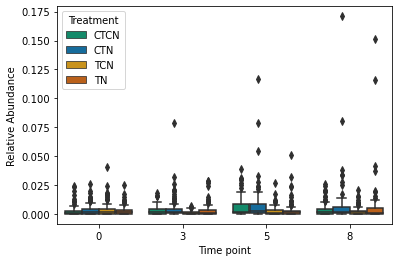

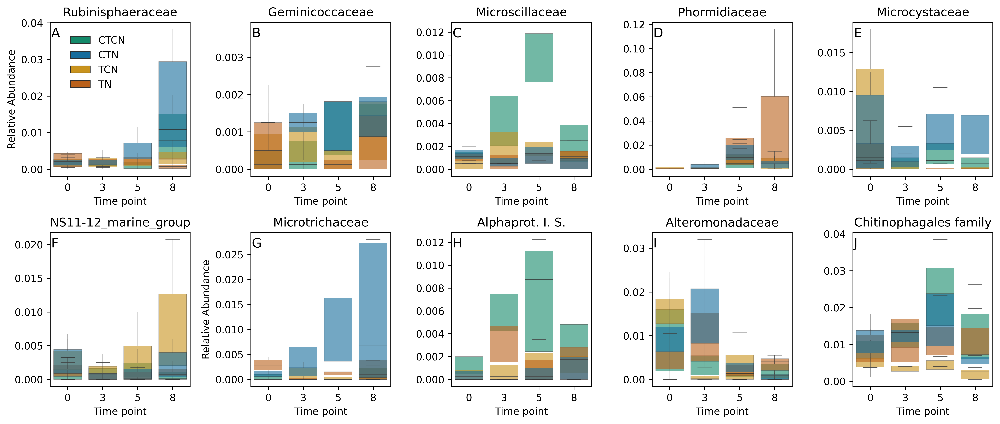

In [52]:
a = narrow
a['Time point'] = a.TP.astype(int)
fig, j =plt.subplots()
sns.boxplot(x='Time point',y='Relative Abundance',data=a, hue='Treatment',palette=['#009e73','#0072b2','#e69d00','#d55e00'],ax = j)
handles, labels = j.get_legend_handles_labels()


fig, axes = plt.subplots(ncols=5, nrows=2,tight_layout=True, figsize=(14,6),dpi=600)

inds = [0,0,0,1,0,2,0,3,0,4,1,0,1,1,1,2,1,3,1,4]
ind=0

ax_labels = list("ABCDEFGHIJK")

for order in set(a.family):
    colors = ['#009e73','#e69d00','#d55e00','#0072b2']
    ax = axes[inds.pop(0)][inds.pop(0)]
    for treat in ['CTCN','TCN','TN','CTN']:
        
        sns.boxplot(x='Time point', linewidth=0.2,
                    y='Relative Abundance',
                    data=a.loc[((a.family==order)&(a.Treatment==treat))],
                    color=colors.pop(0),
                    ax=ax,
                    showfliers=False,boxprops=dict(alpha=.6))

    ax.annotate(ax_labels.pop(0),xy=(0,1),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)

    if ind != 0:
        ax.legend().remove()
    else:
        ax.legend(handles, labels, frameon=False,loc=0,bbox_to_anchor=(0.6,0.97))
    if ind not in [0,6]:
        ax.set_ylabel('')

    #bottom, top = ax.get_ylim()
    #for i in [0.5, 1.5, 2.5]:
    #    ax.axvline(x=i,ymin=0,ymax=1,color='orange')
    ax.set_title(order)
    if order.startswith('Alpha'):
        ax.set_title('Alphaprot. I. S.')
    
    ind += 1
    
#fig.savefig('ancom_fam_boxplot.png',bbox_inches='tight')

**SB-TY test**

In [53]:
def distance_matrix(qza):
    a = !unzip $qza
    digest = a[1].split('/')[0].replace('  inflating: ','')
    inf = digest + '/data/distance-matrix.tsv'
    matrix = pd.read_csv(inf,sep='\t',index_col=0)
    !rm -r $digest
    return matrix

narrow2  = pd.DataFrame(columns = ['metric','Treatment','TP','a','b','Site_a','Site_b','withinamong','distance'])
narrow2.index.name = 'sample_name'

metadata = pd.read_csv('metadata.tsv', index_col=0,sep='\t')
for metric in ['weighted','unweighted']:
    matrix = distance_matrix('DIVERSITY_epiphytes/%s_unifrac_distance_matrix.qza' % (metric))
    samples = metadata.index.tolist()
    samples = [i for i in samples if i in matrix.index.tolist()]
    for t in set(metadata['T']):
        for i in range(len(samples)):
            for j in range(i+1,len(samples)):
                a = samples[i]
                b = samples[j]
                Site_a = metadata.at[a,'SourceSite']
                Site_b = metadata.at[b,'SourceSite']
                Treatment_a = metadata.at[a,'Treatment']
                Treatment_b = metadata.at[b,'Treatment']
                TP_a = metadata.at[a,'T']
                TP_b = metadata.at[b,'T']
                if isinstance(TP_a,float) or isinstance(TP_b,float):
                    continue
                if TP_a != TP_b or Treatment_a != Treatment_b or TP_a != t:
                    continue
                within = None
                if Site_a == Site_b:
                    within = 'within %s' % Site_a
                else:
                    within = 'among sites'
                distance = matrix.at[a,b]
                narrow2.loc[len(narrow2)] = [metric,Treatment_a,TP_a,a,b,Site_a,Site_b,within,distance]
            
narrow2.index.name = 'sample_name'
for metric in ['weighted','unweighted']:
    for t in set(metadata['T']):
        if isinstance(t,float):
            continue
        table = 'DIVERSITY_epiphytes/%s_%s_within_vs_among_sites.tsv' % (t,metric)
        qzv = table.replace('.tsv','.qzv')
        narrow2.loc[((narrow2.metric==metric)&(narrow2.TP==t))].to_csv(table,sep='\t')
        !qiime longitudinal anova \
            --m-metadata-file $table \
            --p-formula "distance ~ withinamong + Treatment" \
            --o-visualization $qzv

Saved Visualization to: DIVERSITY_epiphytes/8tp_weighted_within_vs_among_sites.qzv
Saved Visualization to: DIVERSITY_epiphytes/0tp_weighted_within_vs_among_sites.qzv
Saved Visualization to: DIVERSITY_epiphytes/3tp_weighted_within_vs_among_sites.qzv
Saved Visualization to: DIVERSITY_epiphytes/5tp_weighted_within_vs_among_sites.qzv
Saved Visualization to: DIVERSITY_epiphytes/8tp_unweighted_within_vs_among_sites.qzv
Saved Visualization to: DIVERSITY_epiphytes/0tp_unweighted_within_vs_among_sites.qzv
Saved Visualization to: DIVERSITY_epiphytes/3tp_unweighted_within_vs_among_sites.qzv
Saved Visualization to: DIVERSITY_epiphytes/5tp_unweighted_within_vs_among_sites.qzv


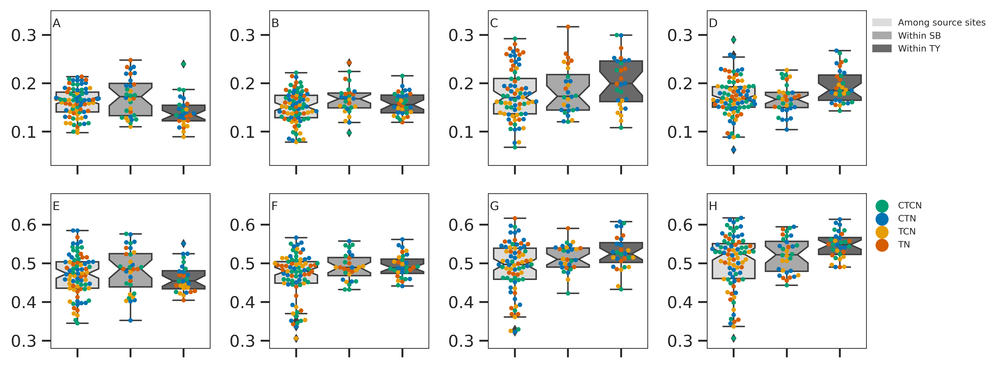

In [55]:
fig, axes = plt.subplots(nrows=2,ncols=4,tight_layout = True,dpi=600,figsize=(9.5,3.6))
metrics = ['weighted','unweighted']
letter = 'a'
among = mpatches.Patch(color='gainsboro', label='Among source sites')
SB = mpatches.Patch(color='darkgray', label='Within SB')
TY = mpatches.Patch(color='dimgray', label='Within TY')
pal={'CTCN':'#009e73','CTN':'#0072b2','TCN':'#e69d00','TN':'#d55e00'}
for row in axes:
    metric = metrics.pop(0)
    tps = ['0tp','3tp','5tp','8tp']
    ylim = (0.03,0.35)
    if metric == 'unweighted':
        ylim=(0.28,0.68)
    for ax in row:
        tp = tps.pop(0)
        a = narrow2.loc[((narrow2.TP==tp)&(narrow2.metric==metric))]
        sns.boxplot(x='withinamong',y='distance',data=a,ax=ax,notch=True,palette=['gainsboro','darkgray','dimgray'],linewidth=1,fliersize=3)
        sns.swarmplot(x='withinamong',y='distance',data=a,ax=ax,hue='Treatment',palette=pal,size=3)
        ax.annotate(letter.upper(),xy=(0,1),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=8)
        ax.set_xlabel('')
        ax.set_ylabel('')
        letter = chr(ord(letter) + 1)
        red_patch = mpatches.Patch(color='red', label='The red data')
        blue_patch = mpatches.Patch(color='blue', label='The blue data')
        if letter == 'e':
            ax.legend(handles=[among, SB, TY],loc=1,bbox_to_anchor=(1.8,1),fontsize=6,frameon=False)
        elif letter != 'i':
            ax.legend().remove()
        else:
            ax.legend(loc=1,bbox_to_anchor=(1.4,1),fontsize=6,frameon=False)
        ax.set_xticklabels([])
        ax.set_ylim(ylim)
fig.savefig('Figures/Fig5.png',bbox_inches='tight')

**Community maturity**

In [57]:
table = Artifact.load('dada/table.epiphyte.no_water.qza').view(pd.DataFrame)
metadata = pd.read_csv('metadata.tsv',index_col=0,sep='\t')
metadata.index.name = 'sample-id'
metadata.loc[table.index.tolist(),:].to_csv('temp',sep='\t')
!mkdir maturity

p = 'Treatment'
v = 'CTCN'
alg = 'KNeighborsRegressor'
outf = 'maturity/%s_%s' % (alg,p)

!qiime longitudinal maturity-index \
    --i-table dada/table.epiphyte.qza \
    --m-metadata-file temp \
    --p-state-column TP \
    --p-group-by $p \
    --p-control $v \
    --p-estimator $alg \
    --p-n-jobs 7 \
    --p-test-size 0.5 \
    --p-n-estimators 150 \
    --p-parameter-tuning \
    --p-stratify \
    --p-random-state 4 \
    --output-dir $outf
!rm temp

Saved SampleEstimator[Regressor] to: maturity/KNeighborsRegressor_Treatment/sample_estimator.qza
Saved FeatureData[Importance] to: maturity/KNeighborsRegressor_Treatment/feature_importance.qza
Saved SampleData[RegressorPredictions] to: maturity/KNeighborsRegressor_Treatment/predictions.qza
Saved Visualization to: maturity/KNeighborsRegressor_Treatment/model_summary.qzv
Saved Visualization to: maturity/KNeighborsRegressor_Treatment/accuracy_results.qzv
Saved SampleData[RegressorPredictions] to: maturity/KNeighborsRegressor_Treatment/maz_scores.qza
Saved Visualization to: maturity/KNeighborsRegressor_Treatment/clustermap.qzv
Saved Visualization to: maturity/KNeighborsRegressor_Treatment/volatility_plots.qzv


Text(1, -5, 'B')

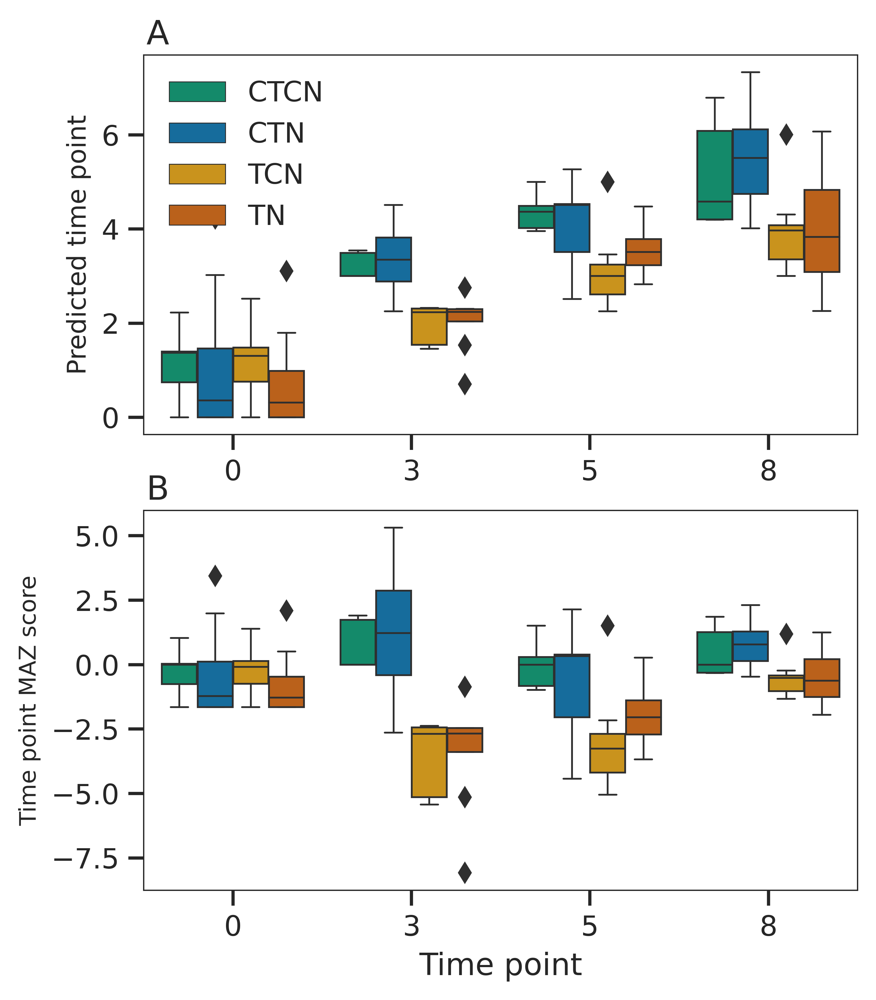

In [58]:
a = !unzip maturity/KNeighborsRegressor_Treatment/volatility_plots.qzv
digest = a[1].split('/')[0].replace('  inflating: ','')
inf = digest + '/data/data.tsv'
maz = pd.read_csv(inf,index_col=0,sep='\t',comment='#')
!rm -r $digest

pal={'CTCN':'#009e73','CTN':'#0072b2','TCN':'#e69d00','TN':'#d55e00'}
metadata = pd.read_csv('metadata.tsv',index_col=0,sep='\t')

def get_tp(string):
    return metadata.at[string,'TP']

def get_bath(string):
    return metadata.at[string,'BathName']


fig, axes = plt.subplots(nrows=2, figsize=(5,6),dpi=600)
ax = axes[0]
sns.boxplot(x='TP',y='prediction',hue='Treatment', data=maz,ax=ax,palette=pal)
ax.legend(frameon=False).set_title('')
ax.set_xlabel('')
ax.set_ylabel('Predicted time point',fontdict={'size':10})
ax.annotate('A',xy=(0,1.13),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
ax = axes[1]
sns.boxplot(x='TP',y='TP MAZ score',hue='Treatment', data=maz,ax=ax,palette=pal)
ax.legend().set_visible(False)
ax.set_xlabel('Time point')
ax.set_ylabel('Time point MAZ score',fontdict={'size':9})
ax.annotate('B',xy=(0,1.13),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)

Model accuracy

<pre>
Mean squared error	r-value	r-squared	P-value	Std Error	Slope	Intercept
TP	2.911173	0.890163	0.79239	1.474067e-07	0.061261	0.50777	1.442134
</pre>

In [16]:
regr.coef_

array([ 0.        ,  0.00024734,  0.        , ..., -0.02439546,
       -0.00484535,  0.06960195])

### Core ASVs - moved to a new notebook

### Dynamics of explanatory features (orders, families, ASVs)

In [26]:
metadata = pd.read_csv('metadata.tsv',sep='\t',index_col=0)

def get_table(f):
    a = Artifact.load(f).view(pd.DataFrame)
    return a.div(a.sum(axis=1), axis=0)

features = {
    'family':get_table('DIVERSITY_epiphytes/rarefied_table.l5.qza'),
    'order':get_table('DIVERSITY_epiphytes/rarefied_table.l4.qza'),
    'ASV':get_table('DIVERSITY_epiphytes/rarefied_table.qza')
}

summary = pd.read_csv('summary.tsv',sep='\t')
summary = summary.loc[summary.core_only!='yes']

In [28]:
summary_with_means = pd.DataFrame(columns = summary.columns.tolist() + ['treatment',0,3,5,8])

for ind, row in summary.iterrows():
    for treatment in 'CTCN','CTN','TCN','TN':
        summary_with_means.loc[len(summary_with_means)] = row.tolist() + [treatment,0.0,0.0,0.0,0.0]
        
def numerate_level(level):
    return {'order': 0, 'family': 1, 'ASV':2}[level]

summary_with_means['numerical_level'] = summary_with_means.level.apply(numerate_level)

In [29]:
for ind, row in summary_with_means.iterrows():
    biom = features[row['level']]
    values = None
    if row['level'] == 'ASV':
        values = biom.loc[:,[i for i in biom.columns if i.startswith(row['feature'])]]
    elif 'BD7-11' in row['feature']:
        values = biom.loc[:,['d__Bacteria;p__Planctomycetota;c__BD7-11;o__BD7-11']]
    elif 'NS11' in row['feature']:
        values = biom.loc[:,['d__Bacteria;p__Bacteroidota;c__Bacteroidia;o__Sphingobacteriales;f__NS11-12_marine_group']]
    else:
        values = biom.loc[:,[i for i in biom.columns if i.endswith(row['feature'])]]
    if len(values.columns.tolist()) == 0:
        raise RuntimeError(row['feature'])
    for tp in 0,3,5,8:
        samples = metadata.loc[((metadata.Treatment==row['treatment']) & (metadata.Fraction=='epiphyte') & (metadata.TP==tp) )].index.tolist()
        samples = [i for i in samples if i in biom.index]
        summary_with_means.at[ind,tp] = values.loc[samples,:].mean()
            

In [30]:
for feature in set(summary_with_means.feature):
    df = summary_with_means.loc[summary_with_means.feature==feature]
    values = []
    for ind, row in df.iterrows():
        values += row[[0,3,5,8]].tolist()
    minv = min(values)
    maxv = max(values)
    
    def newvalue(fl):
        return (fl-minv)/(maxv-minv)
        
    for ind, row in summary_with_means.iterrows():
        if row['feature'] == feature:
            summary_with_means.at[ind,0] = newvalue(summary_with_means.at[ind,0])
            summary_with_means.at[ind,3] = newvalue(summary_with_means.at[ind,3])
            summary_with_means.at[ind,5] = newvalue(summary_with_means.at[ind,5])
            summary_with_means.at[ind,8] = newvalue(summary_with_means.at[ind,8])

In [31]:
fig, axes = plt.subplots(ncols=4, figsize=(9,16),dpi=600)
j=0
for treatment in 'CTCN','CTN','TCN','TN':
    df = summary_with_means.loc[summary_with_means.treatment==treatment].sort_values(['phylum_class','order','numerical_level','Family','numerical_level','label'])
    df.index = df[['phylum_class','order','Family','label']]
    df.index = ["%s;%s;%s %s" % i for i in df.index]
    df = df[[0,3,5,8]]
    scale = False
    if j == 3:
        scale = True
    sns.heatmap(df,ax=axes[j],cbar=scale)
    axes[j].set_title(treatment)
    for line in [2,15,20,26,28,31,46]:
        axes[j].hlines(line,0,4,color='white',linewidth=3)
    if j > 0:
        axes[j].set_yticklabels([])
    j+=1

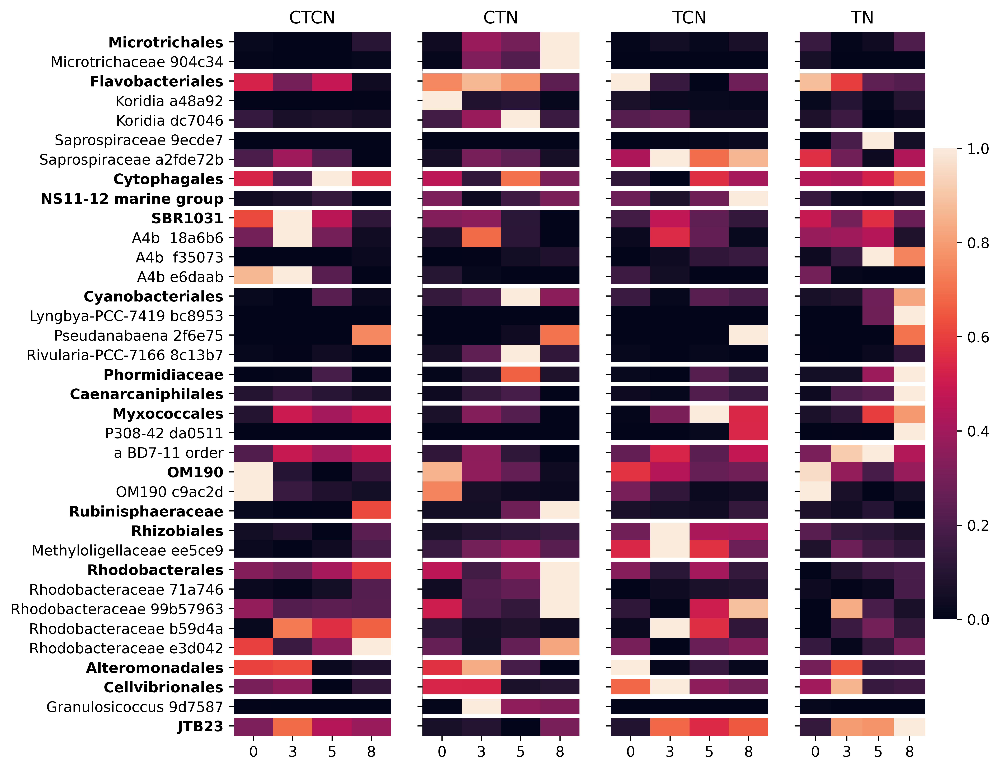

In [34]:
fig, axes = plt.subplots(ncols=4, figsize=(9,9),dpi=600)
j=0
for treatment in 'CTCN','CTN','TCN','TN':
    df = summary_with_means.loc[summary_with_means.treatment==treatment].sort_values(['phylum_class','order','numerical_level','Family','numerical_level','label'])
    df.index = df.label
    df = df[[0,3,5,8]]
    scale = False
    if j == 3:
        scale = True

    sns.heatmap(df,ax=axes[j],cbar=scale)
    axes[j].set_title(treatment)
    axes[j].set_ylabel('')
    for line in [2,5,7,8,9,13,17,18,19,21,25,27,32,33,34,35]:
        axes[j].hlines(line,0,4,color='white',linewidth=3)
    for label in axes[j].get_yticklabels():
        if ' ' not in label.get_text() or label.get_text().startswith('NS11'):
            label.set_weight("bold")
    if j > 0:
        axes[j].set_yticklabels([])
    j+=1
#fig.savefig('heatmap.png',bbox_inches='tight')

In [27]:
def get_tpmax(series):
    values = series[[0,3,5,8]].tolist()
    vmax = max(values)
    vindex = values.index(vmax)
    tps = [0,3,5,8]
    return tps[vindex]

summary_with_means['tp_max'] = summary_with_means.apply(get_tpmax,axis=1)

In [54]:
fig, axes = plt.subplots(ncols=4, figsize=(28,20),dpi=600,tight_layout=True)
j=0
summary_with_means.Family = summary_with_means.Family.fillna('A')
sns.set(font_scale=1.06)
for treatment in 'CTCN','CTN','TCN','TN':
    df = summary_with_means.loc[summary_with_means.treatment==treatment].sort_values(['tp_max','phylum_class','order','Family','numerical_level','label'])
    df.index = df.label
    df = df[[0,3,5,8]]
    scale = False
    if j == 3:
        scale = True
    sns.heatmap(df,ax=axes[j],cbar=scale)
    axes[j].set_title(treatment)
    axes[j].set_ylabel('')
    #for line in [2,15,20,26,28,31,46]:
    #    axes[j].hlines(line,0,4,color='white',linewidth=3)
    #if j > 0:
    #    axes[j].set_yticklabels([])
    j+=1
#fig.savefig('heatmap_vmax_sorted.png',bbox_inches='tight')

In [16]:
import pandas as pd

no = pd.read_csv('NO2.csv',sep='\t')
nh = pd.read_csv('NH4.csv',sep='\t')
p = pd.read_csv('PO4.csv',sep='\t')

data = {
    '$NO_2$':no,
    '$NH_4$':nh,
    '$PO_4$':p,
}

names = ['NO2','NH4','PO4']

nutrients = pd.DataFrame(columns=['Time Point','Treatment','Nutrient', u"Concentration \u03bcM"])
treatments = ['','CTCN','CTN','TCN','TN']

for n in data:
    i = names.pop(0)
    for ind, row in data[n].iterrows():
        nutrients.loc[len(nutrients)] = [int(row['Time period'][1]),treatments[int(row['Bath'])],n,row[i]]
        nutrients.loc[len(nutrients)] = [int(row['Time period'][1]),treatments[int(row['Bath'])],n,row[i]+row['CI']]
        nutrients.loc[len(nutrients)] = [int(row['Time period'][1]),treatments[int(row['Bath'])],n,row[i]-row['CI']]
nutrients.to_csv('nutrients.tsv',sep='\t')

a = pd.read_csv('Temperature.tsv',sep='\t')
a = a.loc[a['Time point']!='ignore']

temperatures = pd.DataFrame(columns=['Time Point','Treatment', 'Temp.$^\circ$C'])
treatments = ['','CTCN','CTN','TCN','TN']

for ind, row in a.iterrows():
    for i in range(1,5):
        temperatures.loc[len(temperatures)] = [row['Time point'],treatments[i],row[i]]

mort = pd.read_csv('mortality.csv')

newshoots = pd.read_csv('number_new_shoots_for_amir_05.07.2021.csv',sep='\t')

In [3]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

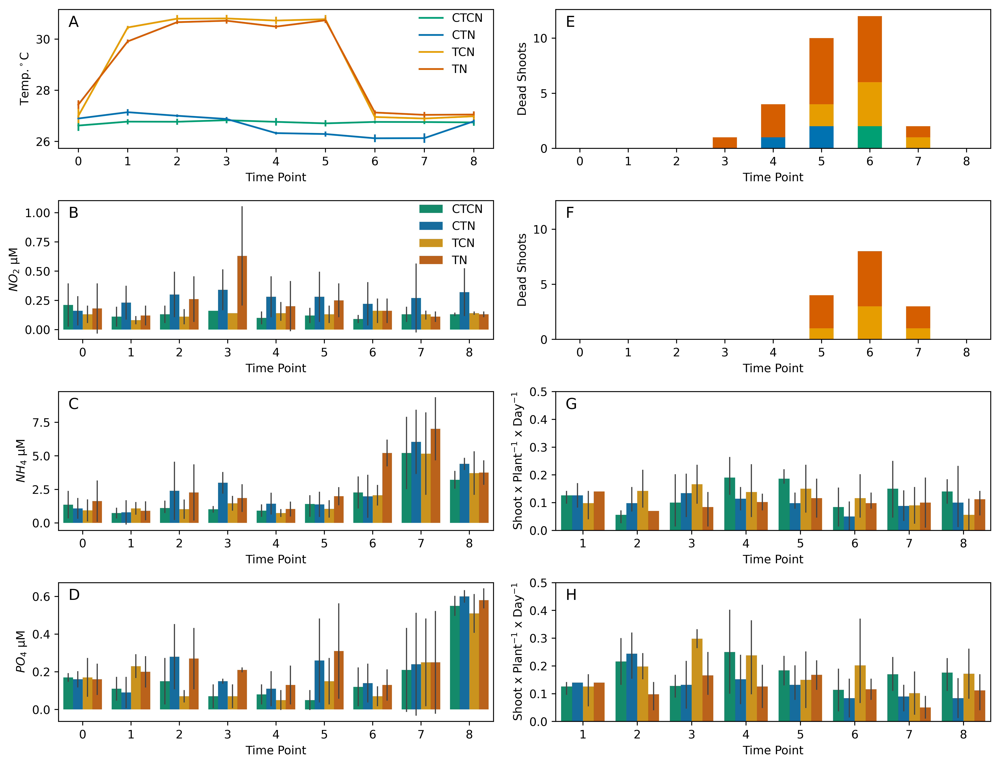

In [11]:
pal={'CTCN':'#009e73','CTN':'#0072b2','TCN':'#e69d00','TN':'#d55e00'}

fig, axes = plt.subplots(nrows=4,ncols=2, figsize=(12,9.3),tight_layout=True,dpi=600)
indexes = [0,0,1,0,2,0,3,0,0,1,1,1,2,1,3,1]
letters = ['A','B','C','D','E','F','G','H']

ax = axes[indexes.pop(0)][indexes.pop(0)]
sns.lineplot(x='Time Point',y='Temp.$^\circ$C',
            data=temperatures,
            hue='Treatment',palette=pal,ax=ax,err_style='bars')
l = letters.pop(0)
ax.annotate(l,xy=(0.02,1),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
ax.legend(loc=1,bbox_to_anchor=(1,1.05),fontsize=10,frameon=False)

for n in data:
    ax = axes[indexes.pop(0)][indexes.pop(0)]
    sns.barplot(x='Time Point',y=u"Concentration \u03bcM",
                data=nutrients.loc[nutrients.Nutrient==n],
                hue='Treatment',palette=pal,ax=ax,errwidth=1)
    l = letters.pop(0)
    if l == 'B':
        ax.legend(loc=1,bbox_to_anchor=(1,1.05),fontsize=10,frameon=False)
    else:
        ax.legend().remove()
    ax.annotate(l,xy=(0.02,1),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
    ax.set_ylabel(n+u" \u03bcM")

ylim = None
for site in 'SB','TY':    
    a = pd.pivot_table(mort.loc[mort['Source site'] == site],index='Time Point',columns='Treatment',values='Dead shoots')
    ax = axes[indexes.pop(0)][indexes.pop(0)]
    a.plot(kind='bar',stacked=True,ax=ax,rot=0,color=pal.values())
    l = letters.pop(0)
    ax.legend().remove()
    ax.annotate(l,xy=(0.02,1),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
    if ylim:
        ax.set_ylim(ylim)
    ylim = ax.get_ylim()
    ax.set_ylabel("Dead Shoots")
    
for site in 'SB','TY': 
    ax = axes[indexes.pop(0)][indexes.pop(0)]
    sns.barplot(x='TIME',y="NUMBS",
                data=newshoots.loc[((newshoots["POPULATION"]==site)&(newshoots["TIME"]!=0))],
                hue='TREATMENT',palette=pal,ax=ax,errwidth=1)
    l = letters.pop(0)
    if l == 'B':
        ax.legend(loc=1,bbox_to_anchor=(1,1.05),fontsize=10,frameon=False)
    else:
        ax.legend().remove()
    ax.annotate(l,xy=(0.02,1),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
    ax.set_ylabel("Shoot x Plant$^{-1}$ x Day$^{-1}$")
    ax.set_ylim(0,newshoots.NUMBS.max())
    ax.set_xlabel('Time Point')
    
fig.savefig('Figures/Fig2.png',bbox_inches='tight')

In [19]:
from statsmodels.formula.api import ols
import statsmodels.api as sm 

lm = ols('NUMBS ~ C(TREATMENT, Sum)*C(POPULATION, Sum)*C(TIME , Sum)', data=newshoots.loc[newshoots.TIME!=0]).fit()
table = sm.stats.anova_lm(lm, typ=3)
print(table)


                                                     sum_sq     df  \
Intercept                                          5.647188    1.0   
C(TREATMENT, Sum)                                  0.108731    3.0   
C(POPULATION, Sum)                                 0.125215    1.0   
C(TIME, Sum)                                       0.127180    7.0   
C(TREATMENT, Sum):C(POPULATION, Sum)               0.023953    3.0   
C(TREATMENT, Sum):C(TIME, Sum)                     0.241192   21.0   
C(POPULATION, Sum):C(TIME, Sum)                    0.071522    7.0   
C(TREATMENT, Sum):C(POPULATION, Sum):C(TIME, Sum)  0.089479   21.0   
Residual                                           2.004040  256.0   

                                                            F        PR(>F)  
Intercept                                          721.382847  1.946177e-76  
C(TREATMENT, Sum)                                    4.629834  3.582841e-03  
C(POPULATION, Sum)                                  15.995250  8.

In [60]:
from qiime2 import Artifact


table = Artifact.load('DIVERSITY_epiphytes/rarefied_table.qza').view(pd.DataFrame)
metadata = pd.read_csv('metadata.tsv',sep='\t',index_col=0)
metadata = metadata.loc[table.index,:]

table = table.transpose()

m = pd.DataFrame(columns=table.columns)
m.loc['Treatment'] = [metadata.at[i, 'Treatment'] for i in table.columns]
#m.loc['subject'] = list(range(len(table.columns)))

lefse = pd.concat([m,table])
lefse.to_csv('lefse.tsv' ,sep='\t',header=False)

In [67]:
lefse0 = pd.read_csv('lefse_0.res',sep='\t',header=None)
lefse0['time point'] = 0
lefse3 = pd.read_csv('lefse_3.res',sep='\t',header=None)
lefse3['time point'] = 3

lefse5 = pd.read_csv('lefse_5.res',sep='\t',header=None)
lefse5['time point'] = 5
lefse8 = pd.read_csv('lefse_8.res',sep='\t',header=None)
lefse8['time point'] = 8
lefse = pd.concat([lefse0,lefse3,lefse5,lefse8])

In [98]:
table = Artifact.load('DIVERSITY_epiphytes/rarefied_table.qza').view(pd.DataFrame)
table = table.div(table.sum(axis=1),axis=0)
table = table.loc[:,set([i.replace('f_','') for i in  lefse.loc[lefse[3]>4][0]])]
taxa = Artifact.load('dada/taxonomy.qza').view(pd.DataFrame)
metadata = pd.read_csv('metadata.tsv',sep='\t',index_col=0)
narrow = pd.DataFrame(columns = ['ASV','Treatment','Relative abundance','Time point'])

for ind, row in table.iterrows():
    treat = metadata.at[ind,'Treatment']
    tp = metadata.at[ind,'TP']
    for col in table:
        taxon_list = taxa.at[col, 'Taxon'].split(';')
        taxon = taxon_list.pop(-1)
        while 'uncultured' in taxon:
            taxon = taxon = taxon_list.pop(-1)
        taxon = taxon.split('__')[-1]
        asv = taxon + ' ' + col[:6]
        narrow.loc[len(narrow)] = [asv, treat, row[col],tp]

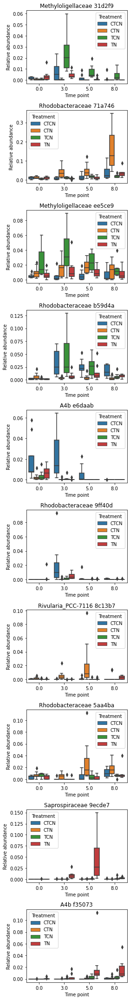

In [112]:
fig, axes = plt.subplots(nrows=len(set(narrow.ASV)), figsize=(4, 30),tight_layout=True)
x=0
for asv in set(narrow.ASV):
    
    sns.boxplot(data=narrow.loc[narrow.ASV==asv],x='Time point',y='Relative abundance',hue='Treatment',ax = axes[x])
    axes[x].set_title(asv)
    x += 1
    
fig.savefig('lefse_box.png')

(array([6., 7., 0., 5., 1., 2., 2., 3., 0., 0., 1., 1., 0., 0., 2., 0., 0.,
        1., 0., 0., 0., 3., 0., 0., 0., 1., 0., 0., 0., 1.]),
 array([0.73      , 0.93933333, 1.14866667, 1.358     , 1.56733333,
        1.77666667, 1.986     , 2.19533333, 2.40466667, 2.614     ,
        2.82333333, 3.03266667, 3.242     , 3.45133333, 3.66066667,
        3.87      , 4.07933333, 4.28866667, 4.498     , 4.70733333,
        4.91666667, 5.126     , 5.33533333, 5.54466667, 5.754     ,
        5.96333333, 6.17266667, 6.382     , 6.59133333, 6.80066667,
        7.01      ]),
 <a list of 30 Patch objects>)

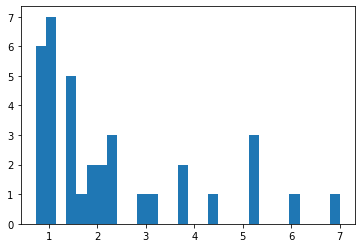

In [616]:
plt.hist([float(i) for i in """1.36
1.08
0.93
1.62
0.73
0.78
1.08
0.9
1.11
2.39
1.02
2.27
1.01
2.99
1.46
1.85
0.91
1.43
0.73
1.03
1.41
1.38
1.04
1.99
2.27
1.98
2.06
5.21
5.21
6.04
5.16
7.01
3.21
4.4
3.71
3.75
""".splitlines()],bins=30
)

In [619]:
from qiime2 import Artifact


table = Artifact.load('DIVERSITY_epiphytes/rarefied_table.qza').view(pd.DataFrame)

metadata = pd.read_csv('metadata.tsv',sep='\t',index_col=0)
metadata = metadata.loc[table.index,:]
nh = pd.read_csv('NH4.csv',sep='\t')
nh = nh.loc[nh.Group!='ignore']
def select(series):
    bath = int(series['Bath'])
    tp = int(series['TP'])
    for ind, row in nh.iterrows():
        if row.Bath == bath and int(row['Time period'][1]) == tp:
            return row.Group
    return 'ignore'
metadata['NH4 group'] = metadata.apply(select,axis=1)
metadata = metadata.loc[metadata['NH4 group']!='ignore']

table = table.loc[metadata.index,:] 

table = table.transpose()

m = pd.DataFrame(columns=table.columns)
m.loc['Temperature'] = metadata.Temp
m.loc['NH4'] = [metadata.at[i, 'NH4 group'] for i in table.columns]

lefse = pd.concat([m,table])
lefse.to_csv('lefse_nh4.tsv' ,sep='\t',header=False)

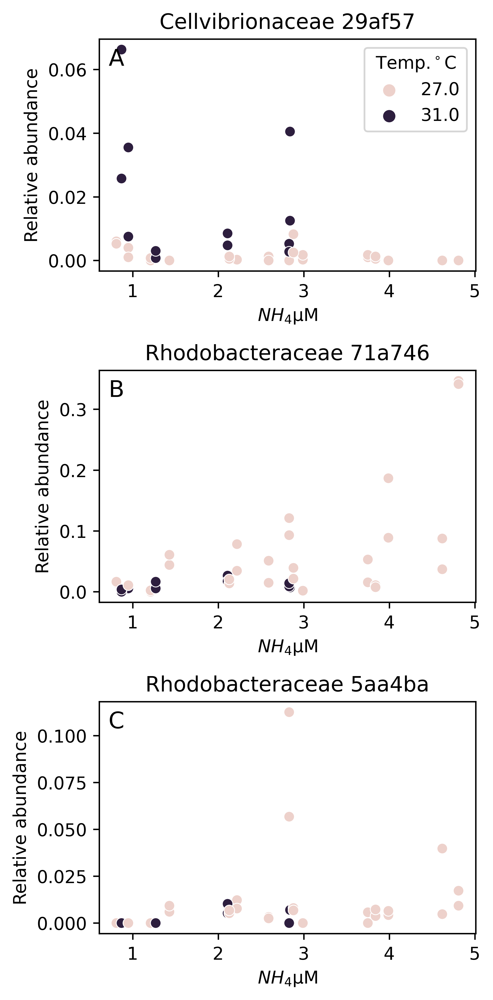

In [630]:
lefse = pd.read_csv('lefse_nh4.res',sep='\t',header=None)

table = Artifact.load('DIVERSITY_epiphytes/rarefied_table.qza').view(pd.DataFrame)
table = table.div(table.sum(axis=1),axis=0)
table = table.loc[:,set([i.replace('f_','') for i in  lefse.loc[lefse[3]>3.7][0]])]
metadata = pd.read_csv('metadata.tsv',sep='\t',index_col=0)
metadata = metadata.loc[table.index,:]
nh = pd.read_csv('NH4.tsv',sep='\t')
nh = nh.loc[nh.Group!='ignore']
def select(series):
    tank = int(series['Tank'])
    tp = int(series['TP'])
    for ind, row in nh.iterrows():
        if row.AQ == tank and int(row['Time Period'][1]) == tp:
            return row['c IS NH4 [uM]']
    return 'ignore'
metadata['$NH_4$'+u" \u03bcM"] = metadata.apply(select,axis=1)
metadata['Temp.$^\circ$C'] = metadata.Temp
metadata = metadata.loc[metadata['$NH_4$'+u" \u03bcM"]!='ignore']

table = table.loc[metadata.index,:] 

narrow = pd.DataFrame(columns = ['ASV',u"$NH_4$\u03bcM",'Relative abundance','Temp.$^\circ$C'])

for ind, row in table.iterrows():
    conc = metadata.at[ind,'$NH_4$'+u" \u03bcM"]
    t = metadata.at[ind,'Temp.$^\circ$C']
    for col in table:
        taxon_list = taxa.at[col, 'Taxon'].split(';')
        taxon = taxon_list.pop(-1)
        while 'uncultured' in taxon:
            taxon = taxon = taxon_list.pop(-1)
        taxon = taxon.split('__')[-1]
        asv = taxon + ' ' + col[:6]
        narrow.loc[len(narrow)] = [asv, conc, row[col],t]

nrows = len(set(narrow.ASV))
fig, axes = plt.subplots(nrows=nrows,tight_layout=True,figsize=(4,8),dpi=600)
x = 0
letters = ['A','B','C','D','E','F','G','H']

for asv in set(narrow.ASV):
    ax=axes[x]
    x+=1
    sns.scatterplot(x=u"$NH_4$\u03bcM",y='Relative abundance',data=narrow.loc[narrow.ASV==asv],hue='Temp.$^\circ$C',ax=ax)
    ax.set_title(asv)
    l = letters.pop(0)
    if l != 'A':
        ax.legend().remove()
    ax.annotate(l,xy=(0.02,1),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
    
fig.savefig('lefse_asvs_nh4.png',bbox_inches='tight')

(array([2., 1., 3., 2., 7., 3., 0., 4., 0., 1., 1., 1., 1., 1., 0., 1., 1.,
        1., 2., 1., 0., 1., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1.]),
 array([0.08 , 0.091, 0.102, 0.113, 0.124, 0.135, 0.146, 0.157, 0.168,
        0.179, 0.19 , 0.201, 0.212, 0.223, 0.234, 0.245, 0.256, 0.267,
        0.278, 0.289, 0.3  , 0.311, 0.322, 0.333, 0.344, 0.355, 0.366,
        0.377, 0.388, 0.399, 0.41 , 0.421, 0.432, 0.443, 0.454, 0.465,
        0.476, 0.487, 0.498, 0.509, 0.52 , 0.531, 0.542, 0.553, 0.564,
        0.575, 0.586, 0.597, 0.608, 0.619, 0.63 ]),
 <a list of 50 Patch objects>)

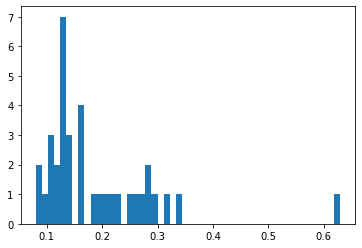

In [622]:
plt.hist([float(i) for i in """0.21
0.16
0.13
0.18
0.11
0.23
0.08
0.12
0.13
0.3
0.11
0.26
0.16
0.34
0.14
0.63
0.1
0.28
0.14
0.2
0.12
0.28
0.13
0.25
0.09
0.22
0.16
0.16
0.13
0.27
0.13
0.11
0.13
0.32
0.14
0.13
""".splitlines()],bins=50
)

In [624]:
table = Artifact.load('DIVERSITY_epiphytes/rarefied_table.qza').view(pd.DataFrame)
metadata = pd.read_csv('metadata.tsv',sep='\t',index_col=0)
metadata = metadata.loc[table.index,:]
nh = pd.read_csv('NO2.csv',sep='\t')
nh = nh.loc[nh.Group!='ignore']
def select(series):
    bath = int(series['Bath'])
    tp = int(series['TP'])
    for ind, row in nh.iterrows():
        if row.Bath == bath and int(row['Time period'][1]) == tp:
            return row.Group
    return 'ignore'
metadata['NO2 group'] = metadata.apply(select,axis=1)
metadata = metadata.loc[metadata['NO2 group']!='ignore']
table = table.loc[metadata.index,:]
    

table = table.transpose()

m = pd.DataFrame(columns=table.columns)
m.loc['Temperature'] = metadata.Temp
m.loc['NO2'] = [metadata.at[i, 'NO2 group'] for i in table.columns]

lefse = pd.concat([m,table])
lefse.to_csv('lefse_no2.tsv' ,sep='\t',header=False)

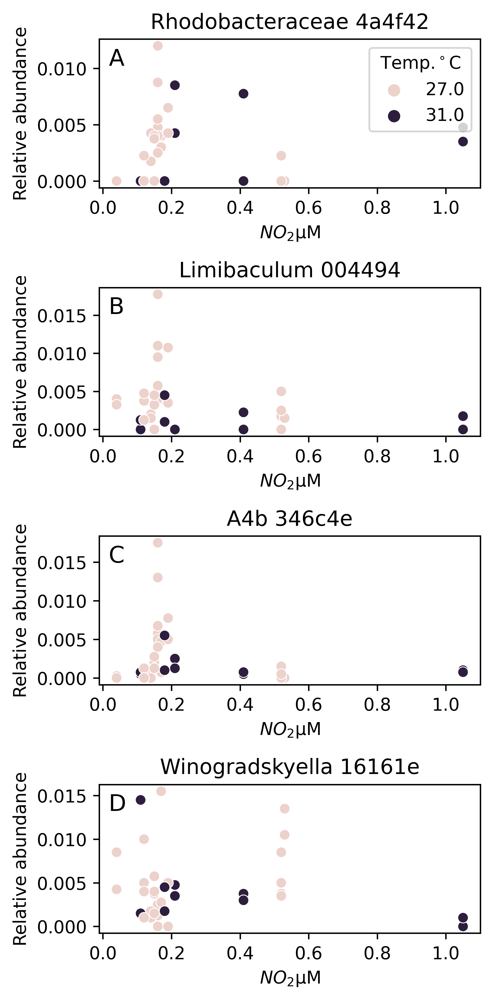

In [634]:
lefse = pd.read_csv('lefse_no2.res',sep='\t',header=None)

table = Artifact.load('DIVERSITY_epiphytes/rarefied_table.qza').view(pd.DataFrame)
table = table.div(table.sum(axis=1),axis=0)
table = table.loc[:,set([i.replace('f_','') for i in  lefse.loc[lefse[3]>3][0]])]
metadata = pd.read_csv('metadata.tsv',sep='\t',index_col=0)
metadata = metadata.loc[table.index,:]
nh = pd.read_csv('NO2.tsv',sep='\t')
nh = nh.loc[nh.Group!='ignore']
def select(series):
    tank = int(series['Tank'])
    tp = int(series['TP'])
    for ind, row in nh.iterrows():
        if row.AQ == tank and int(row['Time Period'][1]) == tp:
            return row['c IS NO2 [uM]']
    return 'ignore'
metadata['$NO_2$'+u" \u03bcM"] = metadata.apply(select,axis=1)
metadata['Temp.$^\circ$C'] = metadata.Temp
metadata = metadata.loc[metadata['$NO_2$'+u" \u03bcM"]!='ignore']

table = table.loc[metadata.index,:] 

narrow = pd.DataFrame(columns = ['ASV',u"$NO_2$\u03bcM",'Relative abundance','Temp.$^\circ$C'])

for ind, row in table.iterrows():
    conc = metadata.at[ind,'$NO_2$'+u" \u03bcM"]
    t = metadata.at[ind,'Temp.$^\circ$C']
    for col in table:
        taxon_list = taxa.at[col, 'Taxon'].split(';')
        taxon = taxon_list.pop(-1)
        while 'uncultured' in taxon:
            taxon = taxon = taxon_list.pop(-1)
        taxon = taxon.split('__')[-1]
        asv = taxon + ' ' + col[:6]
        narrow.loc[len(narrow)] = [asv, conc, row[col],t]

nrows = len(set(narrow.ASV))
fig, axes = plt.subplots(nrows=nrows,tight_layout=True,figsize=(4,8),dpi=600)
x = 0
letters = ['A','B','C','D','E','F','G','H','I','J','K','L']

for asv in set(narrow.ASV):
    ax=axes[x]
    x+=1
    sns.scatterplot(x=u"$NO_2$\u03bcM",y='Relative abundance',data=narrow.loc[narrow.ASV==asv],hue='Temp.$^\circ$C',ax=ax)
    ax.set_title(asv)
    l = letters.pop(0)
    if l != 'A':
        ax.legend().remove()
    ax.annotate(l,xy=(0.02,1),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
    
fig.savefig('lefse_asvs_no2.png',bbox_inches='tight')

(array([2., 0., 4., 1., 1., 0., 2., 1., 2., 1., 3., 0., 2., 2., 0., 0., 1.,
        2., 0., 1., 1., 2., 1., 0., 1., 1., 0., 0., 1., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1.,
        0., 0., 0., 1., 0., 0., 1., 0., 1.]),
 array([0.05      , 0.05916667, 0.06833333, 0.0775    , 0.08666667,
        0.09583333, 0.105     , 0.11416667, 0.12333333, 0.1325    ,
        0.14166667, 0.15083333, 0.16      , 0.16916667, 0.17833333,
        0.1875    , 0.19666667, 0.20583333, 0.215     , 0.22416667,
        0.23333333, 0.2425    , 0.25166667, 0.26083333, 0.27      ,
        0.27916667, 0.28833333, 0.2975    , 0.30666667, 0.31583333,
        0.325     , 0.33416667, 0.34333333, 0.3525    , 0.36166667,
        0.37083333, 0.38      , 0.38916667, 0.39833333, 0.4075    ,
        0.41666667, 0.42583333, 0.435     , 0.44416667, 0.45333333,
        0.4625    , 0.47166667, 0.48083333, 0.49      , 0.49916667,
        0.50833333, 0.5175    , 0.52666667, 0.

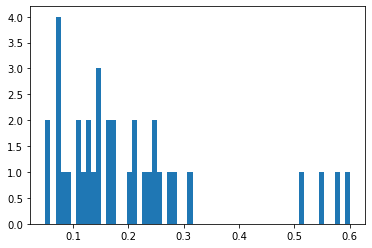

In [626]:
plt.hist([float(i) for i in """0.17
0.16
0.17
0.16
0.11
0.09
0.23
0.2
0.15
0.28
0.07
0.27
0.07
0.15
0.07
0.21
0.08
0.11
0.05
0.13
0.05
0.26
0.15
0.31
0.12
0.14
0.07
0.13
0.21
0.24
0.25
0.25
0.55
0.6
0.51
0.58
""".splitlines()],bins=60
)

In [627]:
table = Artifact.load('DIVERSITY_epiphytes/rarefied_table.qza').view(pd.DataFrame)
metadata = pd.read_csv('metadata.tsv',sep='\t',index_col=0)
metadata = metadata.loc[table.index,:]
nh = pd.read_csv('PO4.csv',sep='\t')
nh = nh.loc[nh.Group!='ignore']
def select(series):
    bath = int(series['Bath'])
    tp = int(series['TP'])
    for ind, row in nh.iterrows():
        if row.Bath == bath and int(row['Time period'][1]) == tp:
            return row.Group
    return 'ignore'
metadata['PO4 group'] = metadata.apply(select,axis=1)
metadata = metadata.loc[metadata['PO4 group']!='ignore']
table = table.loc[metadata.index,:]
    

table = table.transpose()

m = pd.DataFrame(columns=table.columns)
m.loc['Temperature'] = metadata.Temp
m.loc['PO4'] = [metadata.at[i, 'PO4 group'] for i in table.columns]

lefse = pd.concat([m,table])
lefse.to_csv('lefse_po4.tsv' ,sep='\t',header=False)

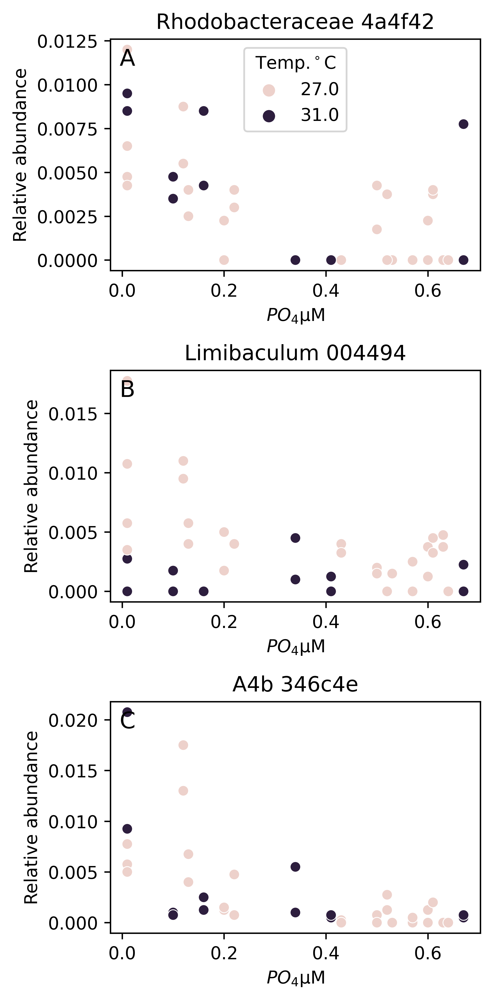

In [641]:
lefse = pd.read_csv('lefse_po4.res',sep='\t',header=None)

table = Artifact.load('DIVERSITY_epiphytes/rarefied_table.qza').view(pd.DataFrame)
table = table.div(table.sum(axis=1),axis=0)
table = table.loc[:,set([i.replace('f_','') for i in  lefse.loc[lefse[3]>3.1][0]])]
metadata = pd.read_csv('metadata.tsv',sep='\t',index_col=0)
metadata = metadata.loc[table.index,:]
nh = pd.read_csv('PO4.tsv',sep='\t')
nh = nh.loc[nh.Group!='ignore']
def select(series):
    tank = int(series['Tank'])
    tp = int(series['TP'])
    for ind, row in nh.iterrows():
        if row.AQ == tank and int(row['Time Period'][1]) == tp:
            return row['c IS PO4 [uM]']
    return 'ignore'
metadata['$PO_4$'+u" \u03bcM"] = metadata.apply(select,axis=1)
metadata['Temp.$^\circ$C'] = metadata.Temp
metadata = metadata.loc[metadata['$PO_4$'+u" \u03bcM"]!='ignore']

table = table.loc[metadata.index,:] 

narrow = pd.DataFrame(columns = ['ASV',u"$PO_4$\u03bcM",'Relative abundance','Temp.$^\circ$C'])

for ind, row in table.iterrows():
    conc = metadata.at[ind,'$PO_4$'+u" \u03bcM"]
    t = metadata.at[ind,'Temp.$^\circ$C']
    for col in table:
        taxon_list = taxa.at[col, 'Taxon'].split(';')
        taxon = taxon_list.pop(-1)
        while 'uncultured' in taxon:
            taxon = taxon = taxon_list.pop(-1)
        taxon = taxon.split('__')[-1]
        asv = taxon + ' ' + col[:6]
        narrow.loc[len(narrow)] = [asv, conc, row[col],t]

nrows = len(set(narrow.ASV))
fig, axes = plt.subplots(nrows=nrows,tight_layout=True,figsize=(4,8),dpi=600)
x = 0
letters = ['A','B','C','D','E','F','G','H','I','J','K','L']

for asv in set(narrow.ASV):
    ax=axes[x]
    x+=1
    sns.scatterplot(x=u"$PO_4$\u03bcM",y='Relative abundance',data=narrow.loc[narrow.ASV==asv],hue='Temp.$^\circ$C',ax=ax)
    ax.set_title(asv)
    l = letters.pop(0)
    if l != 'A':
        ax.legend().remove()
    ax.annotate(l,xy=(0.02,1),xycoords="axes fraction",xytext=(1,-5),textcoords="offset points",ha="left",va="top",size=13)
    
fig.savefig('lefse_asvs_po4.png',bbox_inches='tight')

In [208]:
from qiime2 import Artifact


table = Artifact.load('DIVERSITY_epiphytes/rarefied_table.qza').view(pd.DataFrame)
metadata = pd.read_csv('metadata.tsv',sep='\t',index_col=0)
metadata = metadata.loc[table.index,:]

table = table.transpose()

m = pd.DataFrame(columns=table.columns)
m.loc['Temp'] = [metadata.at[i, 'Temp'] for i in table.columns]
#m.loc['subject'] = list(range(len(table.columns)))

lefse = pd.concat([m,table])
lefse.to_csv('lefse_temp.tsv' ,sep='\t',header=False)

In [225]:
table = Artifact.load('DIVERSITY_epiphytes/rarefied_table.qza').view(pd.DataFrame)
table = table.div(table.sum(axis=1),axis=0)
lefse = pd.read_csv('lefse_temp.res',sep='\t',header=None)
table = table.loc[:,set([i.replace('f_','') for i in  lefse.loc[lefse[3]>3.7][0]])]
taxa = Artifact.load('dada/taxonomy.qza').view(pd.DataFrame)
metadata = pd.read_csv('metadata.tsv',sep='\t',index_col=0)
narrow = pd.DataFrame(columns = ['ASV','Treatment','Relative abundance','Time point'])

for ind, row in table.iterrows():
    treat = metadata.at[ind,'Treatment']
    tp = metadata.at[ind,'TP']
    for col in table:
        taxon_list = taxa.at[col, 'Taxon'].split(';')
        taxon = taxon_list.pop(-1)
        while 'uncultured' in taxon:
            taxon = taxon = taxon_list.pop(-1)
        taxon = taxon.split('__')[-1]
        asv = taxon + ' ' + col[:6]
        narrow.loc[len(narrow)] = [asv, treat, row[col],tp]

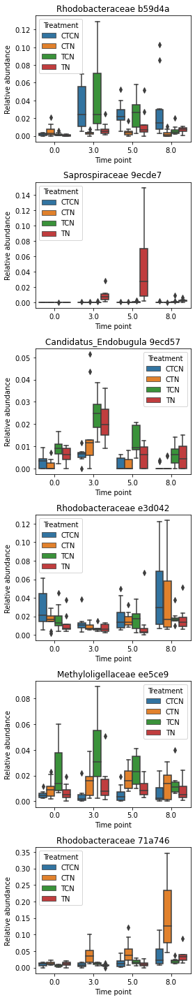

In [227]:
fig, axes = plt.subplots(nrows=len(set(narrow.ASV)), figsize=(4, 20),tight_layout=True)
x=0
for asv in set(narrow.ASV):
    
    sns.boxplot(data=narrow.loc[narrow.ASV==asv],x='Time point',y='Relative abundance',hue='Treatment',ax = axes[x])
    axes[x].set_title(asv)
    x += 1
    
fig.savefig('lefse_box_temp.png')

In [293]:
!qiime vsearch cluster-features-de-novo \
    --i-sequences dada/rep-seqs.qza \
    --i-table dada/table.qza \
    --p-perc-identity 0.97 \
    --p-threads 10 \
    --o-clustered-table vsearch/table.qza \
    --o-clustered-sequences vsearch/rep-seqs.qza \

# Remove Mitochondria, Chloroplast
!qiime taxa filter-table \
  --i-table vsearch/table.qza \
  --i-taxonomy dada/taxonomy.qza \
  --p-exclude Mitochondria,Chloroplast,Eukaryota,mitochondria,chloroplast,eukaryota \
  --o-filtered-table temp.qza

# Remove low frequency features
!qiime feature-table filter-features \
  --i-table temp.qza \
  --p-min-frequency 30 \
  --o-filtered-table temp.qza

!qiime feature-table filter-samples \
  --i-table temp.qza \
  --m-metadata-file metadata.tsv \
  --p-where "[Fraction] IN ('epiphyte')" \
  --o-filtered-table temp.qza

table = Artifact.load('temp.qza').view(pd.DataFrame)
water = Artifact.load('dada/table.water.qza').view(pd.DataFrame)
table = table.loc[:,[i for i in table.columns if i not in water.columns.tolist()]]
table.index.name = '#SampleID'
table.transpose().to_csv('temp',sep='\t')
!biom convert -i temp -o temp.biom --table-type="OTU table" --to-hdf5
!qiime tools import \
  --input-path temp.biom \
  --type 'FeatureTable[Frequency]' \
  --input-format BIOMV210Format \
  --output-path vsearch/table.epiphyte.no_water.qza

!rm tem*

Saved FeatureTable[Frequency] to: vsearch/table.qza
Saved FeatureData[Sequence] to: vsearch/rep-seqs.qza
Saved FeatureTable[Frequency] to: temp.qza
Saved FeatureTable[Frequency] to: temp.qza
Saved FeatureTable[Frequency] to: temp.qza
Saved FeatureTable[Frequency] to: temp.qza
Imported temp.biom as BIOMV210Format to vsearch/table.epiphyte.no_water.qza


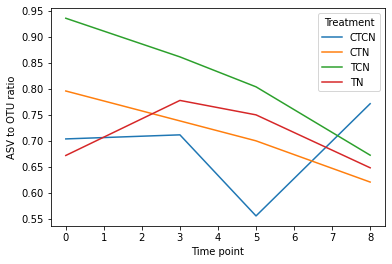

In [320]:
vsearch_table = Artifact.load('vsearch/table.epiphyte.no_water.qza').view(pd.DataFrame)
dada_table = Artifact.load('dada/table.epiphyte.no_water.qza').view(pd.DataFrame)
metadata = pd.read_csv('metadata.tsv',sep='\t',index_col=0)

core_features = open('vsearch/core_features.tsv','wt')
core_features.write('\t'.join(['asv_or_otu','Time point','Treatment','ID\n']))


for t in [0.0,3.0,5.0,8.0]:
    for treatment in ['CTCN','CTN','TCN','TN']:
        samples = metadata.loc[((metadata.TP==t)&(metadata.Treatment==treatment))].index.tolist()
        samples = [i for i in samples if i in dada_table.index]
        asv_table = dada_table.loc[samples,:]
        for col in asv_table:
            if all([i > 0 for i in asv_table[col]]):
                core_features.write('\t'.join( ['asv',str(int(t)),treatment,str(col)])+'\n')
        otu_table = vsearch_table.loc[samples,:]
        for col in vsearch_table:
            if all([i > 0 for i in otu_table[col]]):
                core_features.write('\t'.join( ['otu',str(int(t)),treatment,str(col)])+'\n')
core_features.close()               

core_features = pd.read_csv('vsearch/core_features.tsv',sep='\t')

asv_otu_ratio = pd.DataFrame(columns=['Time point','Treatment','ASV count','OTU count', 'ASV to OTU ratio'])

for t in 0,3,5,8:
    for treatment in ['CTCN','CTN','TCN','TN']:
        num_asvs = len(core_features.loc[((core_features['Time point']==t)&(core_features.Treatment==treatment)&(core_features.asv_or_otu=='asv'))])
        num_otus = len(core_features.loc[((core_features['Time point']==t)&(core_features.Treatment==treatment)&(core_features.asv_or_otu=='otu'))])
        if num_otus == 0:
            continue
        ratio = num_asvs/num_otus
        asv_otu_ratio.loc[len(asv_otu_ratio)] = [t, treatment, num_asvs,num_otus,ratio]

sns.lineplot(x='Time point',y='ASV to OTU ratio',data=asv_otu_ratio,hue='Treatment')

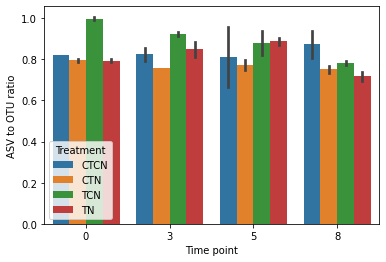

In [341]:
vsearch_table = Artifact.load('vsearch/table.epiphyte.no_water.qza').view(pd.DataFrame)
dada_table = Artifact.load('dada/table.epiphyte.no_water.qza').view(pd.DataFrame)
metadata = pd.read_csv('metadata.tsv',sep='\t',index_col=0)

core_features = open('vsearch/core_features_source.tsv','wt')
core_features.write('\t'.join(['asv_or_otu','Source','Treatment','Time point','ID\n']))


for t in ['TY','SB']:
    for treatment in ['CTCN','CTN','TCN','TN']:
        for tp in [0.0,3.0,5.0,8.0]:
            samples = metadata.loc[((metadata.TP==tp)&(metadata.Treatment==treatment)&(metadata.SourceSite==t))].index.tolist()
            samples = [i for i in samples if i in dada_table.index]
            asv_table = dada_table.loc[samples,:]
            for col in asv_table:
                if all([i > 0 for i in asv_table[col]]):
                    core_features.write('\t'.join( ['asv',t,treatment,str(int(tp)),str(col)])+'\n')
            otu_table = vsearch_table.loc[samples,:]
            for col in vsearch_table:
                if all([i > 0 for i in otu_table[col]]):
                    core_features.write('\t'.join( ['otu',t,treatment,str(int(tp)),str(col)])+'\n')
core_features.close()               

core_features = pd.read_csv('vsearch/core_features_source.tsv',sep='\t')

asv_otu_ratio = pd.DataFrame(columns=['Source','Treatment','Time point','ASV count','OTU count', 'ASV to OTU ratio'])

for t in ['TY','SB']:
    for treatment in ['CTCN','CTN','TCN','TN']:
        for tp in [0.0,3.0,5.0,8.0]:
            num_asvs = len(core_features.loc[((core_features['Source']==t)&(core_features['Time point']==tp)&(core_features.Treatment==treatment)&(core_features.asv_or_otu=='asv'))])
            num_otus = len(core_features.loc[((core_features['Source']==t)&(core_features['Time point']==tp)&(core_features.Treatment==treatment)&(core_features.asv_or_otu=='otu'))])
            if num_otus == 0:
                continue
            ratio = num_asvs/num_otus
            asv_otu_ratio.loc[len(asv_otu_ratio)] = [t, treatment,str(int(tp)), num_asvs,num_otus,ratio]



(0.65, 1.02)

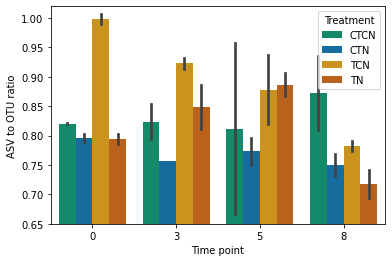

In [357]:
fig, ax = plt.subplots()
pal={'CTCN':'#009e73','CTN':'#0072b2','TCN':'#e69d00','TN':'#d55e00'}
sns.barplot(x='Time point',y='ASV to OTU ratio',data=asv_otu_ratio,hue='Treatment',ci='sd',ax=ax,palette=pal)
ax.set_ylim(0.65,1.02)

In [362]:
unique = []
for ID in set(core_features.ID):
    if len(set(core_features.loc[core_features.ID==ID].Treatment)) == 1:
        unique.append(ID)
        
unique_core_features = core_features.loc[core_features.ID.isin(unique)]

asv_otu_ratio_unique = pd.DataFrame(columns=['Source','Treatment','Time point','ASV count','OTU count', 'ASV to OTU ratio'])

for t in ['TY','SB']:
    for treatment in ['CTCN','CTN','TCN','TN']:
        for tp in [0.0,3.0,5.0,8.0]:
            num_asvs = len(unique_core_features.loc[((unique_core_features['Source']==t)&(unique_core_features['Time point']==tp)&(unique_core_features.Treatment==treatment)&(unique_core_features.asv_or_otu=='asv'))])
            num_otus = len(unique_core_features.loc[((unique_core_features['Source']==t)&(unique_core_features['Time point']==tp)&(unique_core_features.Treatment==treatment)&(unique_core_features.asv_or_otu=='otu'))])
            if num_otus == 0:
                continue
            ratio = num_asvs/num_otus
            asv_otu_ratio_unique.loc[len(asv_otu_ratio_unique)] = [t, treatment,str(int(tp)), num_asvs,num_otus,ratio]

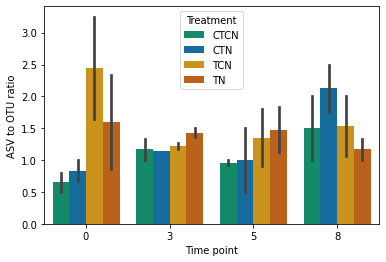

In [365]:
fig, ax = plt.subplots()
pal={'CTCN':'#009e73','CTN':'#0072b2','TCN':'#e69d00','TN':'#d55e00'}
sns.barplot(x='Time point',y='ASV to OTU ratio',data=asv_otu_ratio_unique,hue='Treatment',ci='sd',ax=ax,palette=pal)
#ax.set_ylim(0.65,1.02)

In [ ]:
fig, ax = plt.subplots()
pal={'CTCN':'#009e73','CTN':'#0072b2','TCN':'#e69d00','TN':'#d55e00'}
sns.barplot(x='Time point',y='ASV to OTU ratio',data=asv_otu_ratio,hue='Treatment',ci='sd',ax=ax,palette=pal)
ax.set_ylim(0.65,1.02)

In [354]:
asv_otu_ratio.loc[asv_otu_ratio['Time point']=='0']

,Source,Treatment,Time point,ASV count,OTU count,ASV to OTU ratio
0,TY,CTCN,0,60,73,0.821918
4,TY,CTN,0,73,91,0.802198
8,TY,TCN,0,136,135,1.007407
12,TY,TN,0,122,152,0.802632
16,SB,CTCN,0,68,83,0.819277
20,SB,CTN,0,56,71,0.788732
23,SB,TCN,0,96,97,0.989691
27,SB,TN,0,66,84,0.785714


In [353]:
asv_otu_ratio

,Source,Treatment,Time point,ASV count,OTU count,ASV to OTU ratio
0,TY,CTCN,0,60,73,0.821918
1,TY,CTCN,3,64,75,0.853333
2,TY,CTCN,5,6,9,0.666667
3,TY,CTCN,8,44,47,0.936170
4,TY,CTN,0,73,91,0.802198
5,TY,CTN,3,56,74,0.756757
6,TY,CTN,5,43,54,0.796296
7,TY,CTN,8,30,39,0.769231
8,TY,TCN,0,136,135,1.007407
9,TY,TCN,3,83,89,0.932584


In [643]:
metadata = pd.read_csv('metadata.tsv',sep='\t',index_col=0)

nh = pd.read_csv('PO4.csv',sep='\t')
def select(series):
    try:
        int(series['Tank'])
    except:
        return None
    bath = int(series['Bath'])
    tp = int(series['TP'])
    for ind, row in nh.iterrows():
        if row.Bath == bath and int(row['Time period'][1]) == tp:
            return row['PO4']
    return None
metadata['PO4'] = metadata.apply(select,axis=1)

nh = pd.read_csv('NO2.csv',sep='\t')
def select(series):
    try:
        int(series['Tank'])
    except:
        return None
    bath = int(series['Bath'])
    tp = int(series['TP'])
    for ind, row in nh.iterrows():
        if row.Bath == bath and int(row['Time period'][1]) == tp:
            return row['NO2']
    return None
metadata['NO2'] = metadata.apply(select,axis=1)

nh = pd.read_csv('NH4.csv',sep='\t')
def select(series):
    try:
        int(series['Tank'])
    except:
        return None
    bath = int(series['Bath'])
    tp = int(series['TP'])
    for ind, row in nh.iterrows():
        if row.Bath == bath and int(row['Time period'][1]) == tp:
            return row['NH4']
    return None
metadata['NH4'] = metadata.apply(select,axis=1)

In [644]:
metadata.to_csv('metadata_with_nutrients.tsv',sep='\t')
metadata.to_csv('metadata_with_nutrients.csv')

In [656]:
table = Artifact.load('DIVERSITY_epiphytes/rarefied_table.qza').view(pd.DataFrame)

def site(string):
    return {'TY':0,'SB':1,'W':8}[string]

metadata['scode'] = metadata.SourceSite.apply(site)

#table['Treatment'] = metadata['Treatment']
table['Time point'] = metadata['TP']
table['Source site'] = metadata['scode']
table['Temperature'] = metadata['Temp']
table['NH4'] = metadata['NH4']
table['NO2'] = metadata['NO2']
table['PO4'] = metadata['PO4']
table.to_csv('table_with_metadata.csv')
table.loc[table['Time point']==0].to_csv('table_with_metadata_0.csv')
table.loc[table['Time point']==3].to_csv('table_with_metadata_3.csv')
table.loc[table['Time point']==5].to_csv('table_with_metadata_5.csv')
table.loc[table['Time point']==8].to_csv('table_with_metadata_8.csv')

In [657]:
%%file cca.R

#install.packages("vegan", repos='http://cran.us.r-project.org')

require(vegan)

mm <- read.csv("table_with_metadata.csv",stringsAsFactors = FALSE)
asvs <- mm[,2:2922]
independant <- mm[,2923:2928]

vare.rda <- rda(asvs ~ Temperature + Time.point + Source.site + PO4 + NO2 + NH4, independant)
# overall test
anova(vare.rda)
anova(vare.rda, by="margin",parallel = 10)

Overwriting cca.R


In [658]:
!Rscript cca.R

Loading required package: vegan
Loading required package: permute
Loading required package: lattice
This is vegan 2.5-7
Warning message:
package ‘lattice’ was built under R version 4.0.3 
Permutation test for rda under reduced model
Permutation: free
Number of permutations: 999

Model: rda(formula = asvs ~ Temperature + Time.point + Source.site + PO4 + NO2 + NH4, data = independant)
          Df Variance      F Pr(>F)    
Model      6    39759 5.3138  0.001 ***
Residual 133   165857                  
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1
Permutation test for rda under reduced model
Marginal effects of terms
Permutation: free
Number of permutations: 999

Model: rda(formula = asvs ~ Temperature + Time.point + Source.site + PO4 + NO2 + NH4, data = independant)
             Df Variance      F Pr(>F)    
Temperature   1     5210 4.1779  0.001 ***
Time.point    1     6316 5.0646  0.001 ***
Source.site   1     1827 1.4649  0.096 .  
PO4           1     3785 3.0350

In [650]:
rda_anova = pd.DataFrame([i.split() for i in """Temperature   1     5210 4.1779  0.001 ***
Time.point    1     6316 5.0646  0.001 ***
Source.site   1     1827 1.4649  0.097 .  
PO4           1     3785 3.0350  0.003 ** 
NO2           1     3537 2.8363  0.002 ** 
NH4           1     2368 1.8988  0.032 * """.splitlines()],columns=['factor','df','var','F','p','p1'])
rda_anova['q'] = multipletests(rda_anova.p.astype(float),method='fdr_bh')[1]
rda_anova['prop var'] = rda_anova['var'].astype(int)/(165670+rda_anova['var'].astype(int).sum())
print('explained varianve:',39759/(39759+165857))
rda_anova

explained varianve: 0.1933653023111042


,factor,df,var,F,p,p1,q,prop var
0,Temperature,1,5210,4.1779,0.001,***,0.0030,0.027608
1,Time.point,1,6316,5.0646,0.001,***,0.0030,0.033469
2,Source.site,1,1827,1.4649,0.097,.,0.0970,0.009681
3,PO4,1,3785,3.0350,0.003,**,0.0045,0.020057
4,NO2,1,3537,2.8363,0.002,**,0.0040,0.018743
5,NH4,1,2368,1.8988,0.032,*,0.0384,0.012548


In [662]:
%%file cca_0.R

#install.packages("vegan", repos='http://cran.us.r-project.org')

require(vegan)

mm <- read.csv("table_with_metadata_0.csv",stringsAsFactors = FALSE)
asvs <- mm[,2:2922]
independant <- mm[,2923:2928]

vare.rda <- rda(asvs ~ Temperature + Source.site + PO4 + NO2 + NH4, independant)
# overall test
anova(vare.rda)
anova(vare.rda, by="margin",parallel = 10)

Overwriting cca_0.R


In [663]:
!Rscript cca_0.R

Loading required package: vegan
Loading required package: permute
Loading required package: lattice
This is vegan 2.5-7
Warning message:
package ‘lattice’ was built under R version 4.0.3 
Permutation test for rda under reduced model
Permutation: free
Number of permutations: 999

Model: rda(formula = asvs ~ Temperature + Source.site + PO4 + NO2 + NH4, data = independant)
         Df Variance      F Pr(>F)    
Model     4    23477 2.0554  0.001 ***
Residual 30    85663                  
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1
Permutation test for rda under reduced model
Marginal effects of terms
Permutation: free
Number of permutations: 999

Model: rda(formula = asvs ~ Temperature + Source.site + PO4 + NO2 + NH4, data = independant)
            Df Variance      F Pr(>F)    
Temperature  0        0                  
Source.site  1     6886 2.4116  0.001 ***
PO4          1     5640 1.9753  0.006 ** 
NO2          1     5275 1.8472  0.006 ** 
NH4          1     581

In [666]:
%%file cca_3.R

#install.packages("vegan", repos='http://cran.us.r-project.org')

require(vegan)

mm <- read.csv("table_with_metadata_3.csv",stringsAsFactors = FALSE)
asvs <- mm[,2:2922]
independant <- mm[,2923:2928]

vare.rda <- rda(asvs ~ Temperature + Source.site + PO4 + NO2 + NH4, independant)
# overall test
anova(vare.rda)
anova(vare.rda, by="margin",parallel = 10)

Overwriting cca_3.R


In [667]:
!Rscript cca_3.R

Loading required package: vegan
Loading required package: permute
Loading required package: lattice
This is vegan 2.5-7
Warning message:
package ‘lattice’ was built under R version 4.0.3 
Permutation test for rda under reduced model
Permutation: free
Number of permutations: 999

Model: rda(formula = asvs ~ Temperature + Source.site + PO4 + NO2 + NH4, data = independant)
         Df Variance      F Pr(>F)    
Model     4    35357 2.8137  0.001 ***
Residual 30    94247                  
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1
Permutation test for rda under reduced model
Marginal effects of terms
Permutation: free
Number of permutations: 999

Model: rda(formula = asvs ~ Temperature + Source.site + PO4 + NO2 + NH4, data = independant)
            Df Variance      F Pr(>F)
Temperature  0        0    Inf       
Source.site  1     2333 0.7427  0.814
PO4          0        0   -Inf       
NO2          0        0    Inf       
NH4          0        0   -Inf       
Resi

In [668]:
%%file cca_5.R

#install.packages("vegan", repos='http://cran.us.r-project.org')

require(vegan)

mm <- read.csv("table_with_metadata_5.csv",stringsAsFactors = FALSE)
asvs <- mm[,2:2922]
independant <- mm[,2923:2928]

vare.rda <- rda(asvs ~ Temperature + Source.site + PO4 + NO2 + NH4, independant)
# overall test
anova(vare.rda)
anova(vare.rda, by="margin",parallel = 10)

Writing cca_5.R


In [669]:
!Rscript cca_5.R

Loading required package: vegan
Loading required package: permute
Loading required package: lattice
This is vegan 2.5-7
Warning message:
package ‘lattice’ was built under R version 4.0.3 
Permutation test for rda under reduced model
Permutation: free
Number of permutations: 999

Model: rda(formula = asvs ~ Temperature + Source.site + PO4 + NO2 + NH4, data = independant)
         Df Variance      F Pr(>F)    
Model     4    42354 2.3603  0.001 ***
Residual 29   130098                  
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1
Permutation test for rda under reduced model
Marginal effects of terms
Permutation: free
Number of permutations: 999

Model: rda(formula = asvs ~ Temperature + Source.site + PO4 + NO2 + NH4, data = independant)
            Df Variance      F Pr(>F)
Temperature  0        0    Inf       
Source.site  1     3105 0.6921  0.952
PO4          0        0    Inf       
NO2          0        0    Inf       
NH4          0        0    Inf       
Resi

In [670]:
%%file cca_8.R

#install.packages("vegan", repos='http://cran.us.r-project.org')

require(vegan)

mm <- read.csv("table_with_metadata_8.csv",stringsAsFactors = FALSE)
asvs <- mm[,2:2922]
independant <- mm[,2923:2928]

vare.rda <- rda(asvs ~ Temperature + Source.site + PO4 + NO2 + NH4, independant)
# overall test
anova(vare.rda)
anova(vare.rda, by="margin",parallel = 10)

Writing cca_8.R


In [671]:
!Rscript cca_8.R

Loading required package: vegan
Loading required package: permute
Loading required package: lattice
This is vegan 2.5-7
Warning message:
package ‘lattice’ was built under R version 4.0.3 
Permutation test for rda under reduced model
Permutation: free
Number of permutations: 999

Model: rda(formula = asvs ~ Temperature + Source.site + PO4 + NO2 + NH4, data = independant)
         Df Variance      F Pr(>F)    
Model     4    91339 3.2175  0.001 ***
Residual 31   220011                  
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1
Permutation test for rda under reduced model
Marginal effects of terms
Permutation: free
Number of permutations: 999

Model: rda(formula = asvs ~ Temperature + Source.site + PO4 + NO2 + NH4, data = independant)
            Df Variance      F Pr(>F)  
Temperature  0        0   -Inf         
Source.site  1     5468 0.7704  0.589  
PO4          1     8131 1.1457  0.266  
NO2          1    22495 3.1696  0.011 *
NH4          1    12376 1.7438  

In [672]:
taxa = Artifact.load('dada/taxonomy.qza').view(pd.DataFrame)

In [676]:
taxa.at[[i for i in taxa.index if i.startswith('f4f196')][0],'Taxon']

'd__Bacteria; p__Planctomycetota; c__Planctomycetes; o__Pirellulales; f__Pirellulaceae; g__Blastopirellula'

In [680]:
taxa.loc[taxa.Taxon.str.contains('BD7-11')]['Taxon'].tolist()

['d__Bacteria; p__Planctomycetota; c__BD7-11; o__BD7-11; f__BD7-11; g__BD7-11; s__uncultured_bacterium',
 'd__Bacteria; p__Planctomycetota; c__BD7-11; o__BD7-11; f__BD7-11; g__BD7-11',
 'd__Bacteria; p__Planctomycetota; c__BD7-11; o__BD7-11; f__BD7-11; g__BD7-11; s__uncultured_bacterium',
 'd__Bacteria; p__Planctomycetota; c__BD7-11; o__BD7-11; f__BD7-11; g__BD7-11; s__uncultured_bacterium',
 'd__Bacteria; p__Planctomycetota; c__BD7-11; o__BD7-11; f__BD7-11; g__BD7-11; s__uncultured_bacterium',
 'd__Bacteria; p__Planctomycetota; c__BD7-11; o__BD7-11; f__BD7-11; g__BD7-11; s__uncultured_marine',
 'd__Bacteria; p__Planctomycetota; c__BD7-11; o__BD7-11; f__BD7-11; g__BD7-11; s__uncultured_bacterium',
 'd__Bacteria; p__Planctomycetota; c__BD7-11; o__BD7-11; f__BD7-11; g__BD7-11; s__uncultured_bacterium',
 'd__Bacteria; p__Planctomycetota; c__BD7-11; o__BD7-11; f__BD7-11; g__BD7-11; s__uncultured_bacterium',
 'd__Bacteria; p__Planctomycetota; c__BD7-11; o__BD7-11; f__BD7-11; g__BD7-11; s__u